In [1]:
# Imports
import cv2, os, json, time
import numpy as np
import pandas as pd
from glob import glob
from tqdm import tqdm
import matplotlib.pyplot as plt
from shapely.geometry import Polygon
from matplotlib.lines import Line2D

# load the functions of the OCR model
%run OCR-functions.ipynb

# Analyse the number of pages and redactions per label of the test set

In [2]:
datasets_dir = os.path.join('..', 'datasets')
data_csv = pd.read_csv(os.path.join(datasets_dir, 'data_complete.csv')).set_index('File')
with open(os.path.join(datasets_dir, 'gold_standard_complete.json')) as f:
    annotations = json.load(f)

In [3]:
# get the filenames of the test set
test_files = [f for f in os.listdir(os.path.join(datasets_dir, 'test_extended'))]

# make sure we have the correct number of files
len(test_files)

439

In [4]:
# count the number of redactions per page
# and keep track of their type
result = []
for file in test_files:
    file_annotations = annotations[file]
    redactions = len(file_annotations['regions'])
    result.append([redactions, data_csv.loc[file, 'type']])
result_df = pd.DataFrame(result, columns=['redactions', 'type'])

In [5]:
# get the number of pages and redactions per type and the total
result_alt = {}
for label, label_df in result_df.groupby('type'):
    result_alt[label] = { 'pages': len(label_df), 'redactions': sum(label_df['redactions']) }
result_alt['total'] = { 'pages': len(result_df), 'redactions': sum(result_df['redactions']) }
pd.DataFrame.from_dict(result_alt).T

,pages,redactions
black,94,1349
border,51,914
color,25,545
gray,114,842
no_annotation,155,0
total,439,3650


# Also get them for the train set

In [6]:
test_files = [f for f in os.listdir(os.path.join(datasets_dir, 'train_extended'))]
# count the number of redactions per page
# and keep track of their type
result = []
for file in test_files:
    file_annotations = annotations[file]
    redactions = len(file_annotations['regions'])
    result.append([redactions, data_csv.loc[file, 'type']])
result_df = pd.DataFrame(result, columns=['redactions', 'type'])

In [7]:
# get the number of pages and redactions per type and the total
result_alt = {}
for label, label_df in result_df.groupby('type'):
    result_alt[label] = { 'pages': len(label_df), 'redactions': sum(label_df['redactions']) }
result_alt['total'] = { 'pages': len(result_df), 'redactions': sum(result_df['redactions']) }
pd.DataFrame.from_dict(result_alt).T

,pages,redactions
black,220,2597
border,119,1647
color,58,1128
gray,267,2550
no_annotation,361,0
total,1025,7922


# Load the results

In [8]:
# load the Mask R-CNN results and rename some columns
maskrcnn_results = pd.read_csv(os.path.join('results', 'maskrcnn_results.csv')).rename(columns={"Unnamed: 0": "file", "Label": "type"}).convert_dtypes()

# make sure that we get the file name instead of the path aand set the file as  the index
maskrcnn_results["file"] = maskrcnn_results["file"].map(lambda x: x.split('\\')[-1])
maskrcnn_results = maskrcnn_results.set_index("file").sort_index(axis='index')

# load the detectron results and rename some columns
maskrcnn_extended_results = pd.read_csv(os.path.join('results', 'maskrcnn_extended_results.csv')).rename(columns={"Unnamed: 0": "file", "Label": "type"}).convert_dtypes()

# make sure that we get the file name instead of the path aand set the file as  the index
maskrcnn_extended_results["file"] = maskrcnn_extended_results["file"].map(lambda x: x.split('\\')[-1])
maskrcnn_extended_results = maskrcnn_extended_results.set_index("file").sort_index(axis='index')

# load the ocr results and name the index 'file' since the file names are used for the index
# we also convert the types so that most columns are int instead of float (int is enough)
ocr_results = pd.read_csv(os.path.join('results', 'ocr_results.csv'), index_col=0).convert_dtypes()
ocr_results.index.name = 'file'

# make sure that both dataframes have the same column order
cols = list(maskrcnn_results.columns.values)
ocr_results = ocr_results[cols]

# load the ocr results and name the index 'file' since the file names are used for the index
# we also convert the types so that most columns are int instead of float (int is enough)
ocr_extended_results = pd.read_csv(os.path.join('results', 'ocr_extended_results.csv'), index_col=0).convert_dtypes()
ocr_extended_results.index.name = 'file'

# make sure that both dataframes have the same column order
cols = list(maskrcnn_extended_results.columns.values)
ocr_extended_results = ocr_extended_results[cols]\

# normalize the area with the image size
maskrcnn_extended_results['Ratio redacted area'] = maskrcnn_extended_results['area'] / maskrcnn_extended_results['size']
ocr_extended_results['Ratio redacted area'] = ocr_extended_results['area'] / ocr_extended_results['size']

In [9]:
# show the head of the Mask R-CNN extended results as a check
maskrcnn_extended_results.head()

,TP,FP,FN,IOU,area,size,type,Ratio redacted area
file,,,,,,,,
0007-page1.png,1,1,1,0.870273,2050,3740000,gray,0.000548
0008-page0.png,2,0,0,1.69592,4819,3740000,gray,0.001289
0009-page0.png,2,0,0,1.832536,11930,3740000,gray,0.00319
0011-page0.png,15,0,0,12.800285,62617,3740000,gray,0.016743
0016-page1.png,21,0,0,17.898082,82787,3740000,gray,0.022136


In [10]:
# show the head of the ocr results as a check
ocr_extended_results.head()

,TP,FP,FN,IOU,area,size,type,Ratio redacted area
file,,,,,,,,
0007-page1.png,0,2,2,0.0,3134.0,3740000,gray,0.000838
0008-page0.png,0,2,2,0.0,3140.5,3740000,gray,0.00084
0009-page0.png,0,3,2,0.0,4343.5,3740000,gray,0.001161
0011-page0.png,0,2,15,0.0,3080.0,3740000,gray,0.000824
0016-page1.png,12,3,9,10.20174,106651.5,3740000,gray,0.028516


# KDE plots to see how the models perform

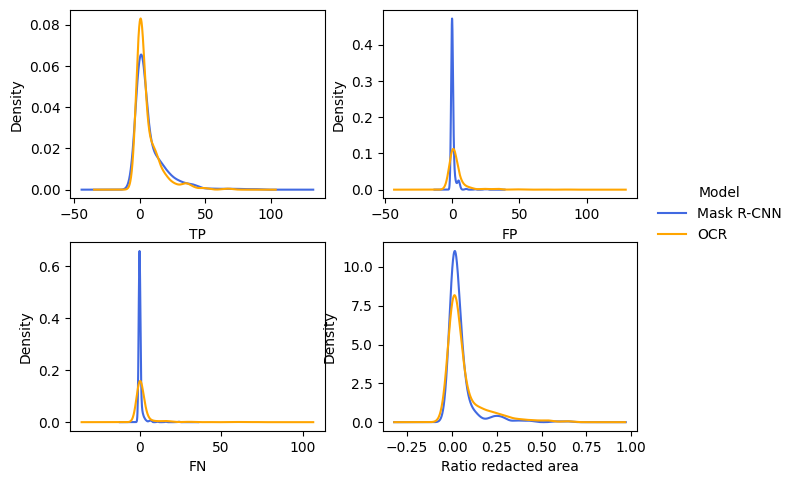

In [11]:
#define number of rows and columns for subplots
nrow=2
ncol=2

# make a list of all dataframes 
columns = ['TP', 'FP', 'FN', 'Ratio redacted area']
fig, axes = plt.subplots(nrow, ncol)
fig.tight_layout() 

# plot counter
count=0
for r in range(nrow):
    for c in range(ncol):
        axes[r,c].set_xlabel(columns[count])
        maskrcnn_extended_results[columns[count]].plot.kde(ax=axes[r,c], label="Mask R-CNN", color='royalblue')
        ocr_extended_results[columns[count]].plot.kde(ax=axes[r,c], label="OCR", color='orange')
        count+=1

# handles for the legend
color_map = {"Mask R-CNN": 'royalblue', 'OCR': 'orange'}
patches = [Line2D([], [], color=v, label=k) for k, v in color_map.items()]  # square patches

# place legend outside of plot; change the right bbox value to move the legend up or down
plt.legend(title='Model', handles=patches, bbox_to_anchor=(1.06, 1.15), loc='center left', borderaxespad=0, frameon=False)
plt.show()

# KDE plots for the documents without redactions
The higher the density is around the 0 the better, it means that we have less false positives and redacted area by the predictions.

In [12]:
maskrcnn_no_annotations = maskrcnn_extended_results[maskrcnn_extended_results['type'] == 'no_annotation']
ocr_no_annotations = ocr_extended_results[ocr_extended_results['type'] == 'no_annotation']

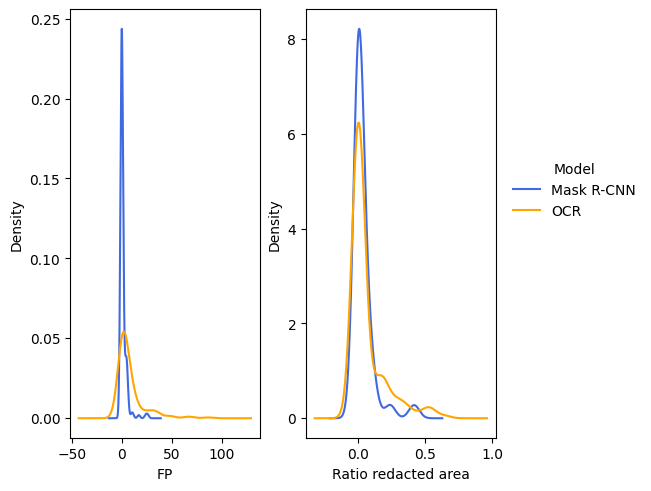

In [13]:
# make a list of all dataframes 
columns = ['FP', 'Ratio redacted area']
fig, axes = plt.subplots(1, 2, constrained_layout = True)

# plot counter
count=0
for r in range(2):
    axes[r].set_xlabel(columns[count])
    maskrcnn_no_annotations[columns[count]].plot.kde(ax=axes[r], label="Mask R-CNN", color='royalblue')
    ocr_no_annotations[columns[count]].plot.kde(ax=axes[r], label="OCR", color='orange')
    count+=1

# place legend outside of plot; change the right bbox value to move the legend up or down
plt.legend(title='Model', handles=patches, bbox_to_anchor=(1.06, 0.5), loc='lower left', borderaxespad=0, frameon=False)
plt.show()

# Documents without false positives or false negatives
Kan mooi staan op de titelpagina :)

In [14]:
def show_image(image):
    
    # make sure that the figure is big enough to clearly see
    plt.figure(figsize=(10, 10))
    
    # cv2 uses BGR and plt uses RGB, so the color channels need to be converted accordingly
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.show()

In [15]:
# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

C:\Users\kdmei\anaconda3\envs\master\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [16]:
# only get the documents with a perfect score
perfect_score_df = maskrcnn_extended_results[(maskrcnn_extended_results['FP'] == 0) &
                        (maskrcnn_extended_results['FN'] == 0)]

# sort by the number of true positives
perfect_score_df.sort_values(by=['TP'], ascending=False).head()

,TP,FP,FN,IOU,area,size,type,Ratio redacted area
file,,,,,,,,
documenten-180-226-61.png,48,0,0,39.943003,1283488,8710364,gray,0.147352
Bijlagen 2 bij Besluit op Woo-verzoek over uitvoering geven door de Staat aan het vonnis van de rechtbank van 14 april 2021-16.png,44,0,0,37.930457,424438,8666000,color,0.048977
122. overleg over Overlast en andere zaken-1.png,44,0,0,34.924802,275682,8415000,black,0.032761
292. RE_ te plannen afspraak wethoud met vertegen_-2.png,43,0,0,35.176598,557603,8686416,black,0.064193
IMAGES_00000_00000_14175046-1.png,40,0,0,33.193391,299732,8415000,black,0.035619


In [17]:
# initial config for the detectron2 model
cfg = get_cfg() # the default config
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x.yaml")) # the config of the coco dataset
cfg.SEED = 117 # set a seed for 

# data config
cfg.DATASETS.TRAIN = ("redacted_train_extended",)
cfg.DATASETS.TEST = () # change this with an actual test set that's not the validation set
cfg.DATALOADER.NUM_WORKERS = 2 # this will alter the speed of the training, my gpu can handle 2
cfg.DATALOADER.FILTER_EMPTY_ANNOTATIONS = False # we also want to know when an image doesn't have any redactions
cfg.INPUT.RANDOM_FLIP = "none"

# model config
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 256   # The "RoIHead batch size". The default is 512, but a smaller size is faster
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # only has one class ('redacted')
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5 # inference score threshold 
# NOTE: this config means the number of classes, but a few popular unofficial tutorials incorrect uses num_classes+1 here.

cfg.OUTPUT_DIR = "output_extended"

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

# create the output dir
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)

In [18]:
# create the metadata for the model
metadata = MetadataCatalog.get("redacted").set(thing_classes=["redacted"])
metadata.set(thing_dataset_id_to_contiguous_id = {'0' : 'redacted'})
metadata.set(stuff_dataset_id_to_contiguous_id = {})

namespace(name='redacted',
          thing_classes=['redacted'],
          thing_dataset_id_to_contiguous_id={'0': 'redacted'},
          stuff_dataset_id_to_contiguous_id={})

C:\Users\kdmei\anaconda3\envs\master\lib\site-packages\torch\functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at C:\actions-runner\_work\pytorch\pytorch\builder\windows\pytorch\aten\src\ATen\native\TensorShape.cpp:3527.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


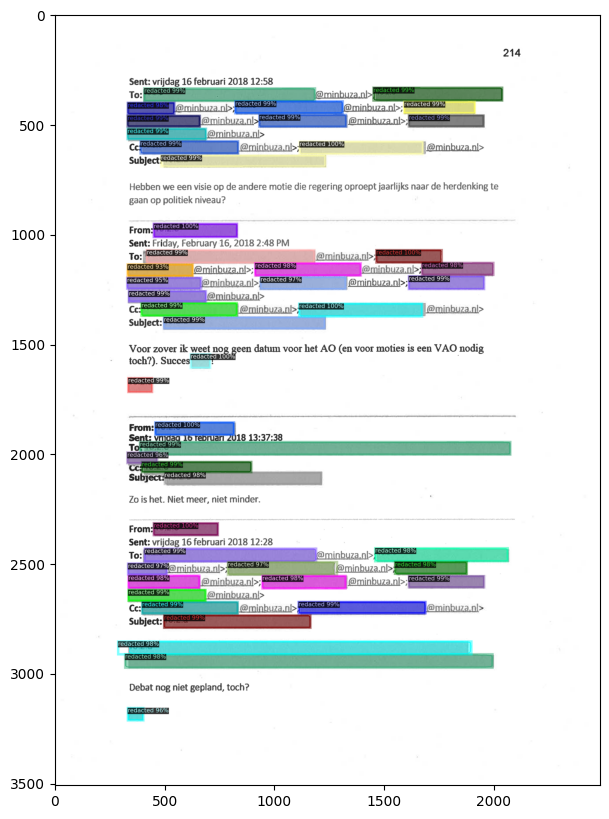

True

In [19]:
# show the prediction of the page with the most true positives
im = cv2.imread(os.path.join(datasets_dir, 'complete', perfect_score_df['TP'].idxmax()))
outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
v = Visualizer(im, metadata=metadata)
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
show_image(out.get_image())
cv2.imwrite(os.path.join('..', 'datasets', 'examples', 'title-image.png'), out.get_image())

# Check the documents with the biggest difference in FP for the documents without any redactions

In [20]:
# get the absolute difference in false positives between the models
# for the documents without redactions 
fp_diffs = (maskrcnn_no_annotations['FP'] - ocr_no_annotations['FP']).abs().sort_values(ascending=False)

# the 5 documents with the biggest difference in false positives
fp_diffs.head(5)

file
Gelakte stukken Wob-verzoek omgevingsproces Ternaard 2e deel-125.png    86
Gelakte stukken Wob-verzoek omgevingsproces Ternaard 2e deel-68.png     68
Gelakte stukken Wob-verzoek omgevingsproces Ternaard 2e deel-174.png    66
Gelakte stukken Wob-verzoek omgevingsproces Ternaard 2e deel-59.png     49
Gelakte stukken Wob-verzoek omgevingsproces Ternaard 2e deel-5.png      49
Name: FP, dtype: Int64

# Check the documents with the biggest difference in PQ

In [21]:
def metric_calculation(dataframe):
    '''
    The metric calculations as done in https://github.com/irlabamsterdam/TPDLTextRedaction/blob/main/notebooks/Experiments.ipynb
    @param  pd.DataFrame    The dataframe for one class with the following columns { IOU, TP, FN, FP }
                            where the IOU is the sum of IOU scores and the others a total count.
    @return dict            The metric scores every separate row
    '''
    
    # result dict
    result = {}
    
    # calculate the pq score for each row separately
    for file, row in dataframe.iterrows():
        SQ = row['IOU'] / row['TP'] if row['TP'] > 0 else 0
        RQ = row['TP'] / (row['TP'] + .5*row['FN'] + .5*row['FP']) if (row['TP'] + .5*row['FN'] + .5*row['FP']) > 0 else 0
        PQ = SQ*RQ
        P = row['TP'] / (row['TP'] + row['FP']) if (row['TP'] + row['FP']) > 0 else 0
        R = row['TP'] / (row['TP'] + row['FN']) if (row['TP'] + row['FN']) > 0 else 0
        result[file] = { 'PQ': round(PQ, 2), 'SQ': round(SQ, 2), 'RQ': round(RQ, 2), 'P': round(P, 2), 'R': round(R, 2) }
    
    # turn the dict into a DataFrame with the filename as the index
    return pd.DataFrame.from_dict(result).T

In [22]:
# get the pq scores for the models per document
maskrcnn_pq = metric_calculation(maskrcnn_results)
ocr_pq = metric_calculation(ocr_results)

In [23]:
# get the absolute difference in PQ between the models
pq_diffs = (maskrcnn_pq['PQ'] - ocr_pq['PQ']).abs().sort_values(ascending=False)

# the 5 documents with the biggest difference in PQ
pq_diffs.head(5)

Bijlagen deel 2 bij Woo-besluit bijverdiensten bestuurders semipublieke sector _WNT_-7.png                                           0.99
Documenten bij Woo-besluit over correspondentie tussen besturen bij totstandkoming rapport Perspectief voor de Gnephoek eo-15.png    0.94
c-sms-berichten-mp-sg-33.png                                                                                                         0.94
Bijlagen bij besluit Woo-verzoek over verantwoord medicijngebruik-134.png                                                            0.93
c-sms-berichten-mp-sg-42.png                                                                                                         0.91
Name: PQ, dtype: float64

# Get the pages with the worst recall for the OCR model
We will do this for the border and the gray redactions a minimum number of true positives and false positives.

In [24]:
def show_ocr_results(df, number_of_samples: int= 5, save_images: bool=True):
    
    # sort by recall lowest to highest and grab the first
    for filename in df.index[:number_of_samples]:
    
        # load the image
        input_image = load_image(os.path.join(datasets_dir, 'complete', filename))

        # do the preprocessing
        image_text_pre, image_box_pre = text_preprocessing(input_image), redaction_box_preprocessing(input_image)

        # remove the text
        image_without_text, total_words_area, text_boundaries = remove_text(image_text_pre, image_box_pre)

        # first contour detection step
        image_with_contours, contours = determine_contours(image_without_text)

        # final contouring filtering step
        final_image_with_contours, _, _, _, _  = filter_contours(input_image, contours, text_boundaries)

        # show the image
        show_image(final_image_with_contours)
        
        # save the image
        if save_images: cv2.imwrite(os.path.join('..', 'datasets', 'examples', 'ocr', filename), final_image_with_contours)

In [25]:
def show_maskrcnn_results(df, number_of_samples: int= 5, save_images: bool=True):
    
    # sort by recall lowest to highest and grab the first
    for filename in df.index[:number_of_samples]:
        
        # show the prediction of the page with the most true positives
        im = cv2.imread(os.path.join(datasets_dir, 'complete', filename))
        outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
        v = Visualizer(im, metadata=metadata)
        out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
        show_image(out.get_image())
        
        # save the image
        if save_images: cv2.imwrite(os.path.join('..', 'datasets', 'examples', 'maskrcnn', filename), out.get_image())

In [26]:
# join the ocr results with the pq score per page
ocr_complete = ocr_results.join(ocr_pq)

## Border redactions first

In [27]:
# filter on the pages with border redactions and sort by the lowest recall
# since these documents have the largest negatige effect on the recall of the ocr model
poor_recall_border = ocr_complete[(ocr_complete['type'] == 'border')].sort_values(by=['R'], ascending=True)
poor_recall_border.head(10)

,TP,FP,FN,IOU,type,PQ,SQ,RQ,P,R
file,,,,,,,,,,
nl.mnre1058.2i.2022.1.misc.9-31.png,0,1,16,0.0,border,0.00,0.00,0.00,0.00,0.00
nl.mnre1058.2i.2022.1.misc.9-42.png,0,1,18,0.0,border,0.00,0.00,0.00,0.00,0.00
nl.mnre1058.2i.2022.1.misc.9-52.png,9,8,58,7.554601,border,0.18,0.84,0.21,0.53,0.13
Documenten bij Woo-besluit over correspondentie tussen besturen bij totstandkoming rapport Perspectief voor de Gnephoek eo-24.png,2,2,9,1.676529,border,0.22,0.84,0.27,0.50,0.18
Ordner1+doc+1-50-27.png,1,1,4,0.781677,border,0.22,0.78,0.29,0.50,0.20
Ordner2+doc+51-100-29.png,1,5,4,0.892068,border,0.16,0.89,0.18,0.17,0.20
woo-niet-evacueren-medewerkers-atvet-documenten-8.png,8,0,30,6.887787,border,0.30,0.86,0.35,1.00,0.21
nl.mnre1058.2i.2022.1.misc.9-46.png,7,4,27,5.399914,border,0.24,0.77,0.31,0.64,0.21
nl.mnre1058.2i.2022.1.misc.9-17.png,19,10,61,16.17793,border,0.30,0.85,0.35,0.66,0.24


In [28]:
poor_recall_border_head = poor_recall_border[:10]
poor_recall_border_head['redactions'] = poor_recall_border_head['TP'] + poor_recall_border_head['FN']

C:\Users\kdmei\AppData\Local\Temp\ipykernel_6768\4054848508.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  poor_recall_border_head['redactions'] = poor_recall_border_head['TP'] + poor_recall_border_head['FN']


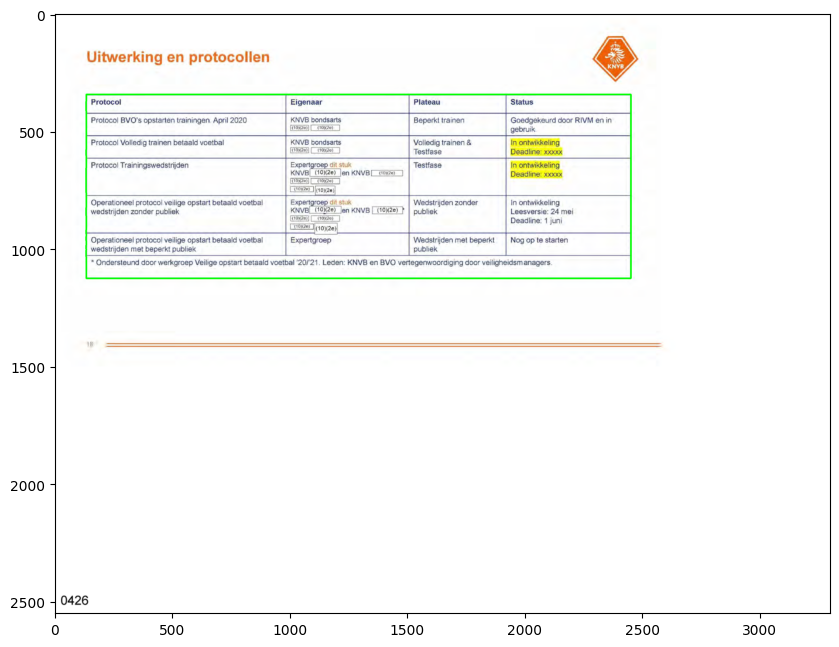

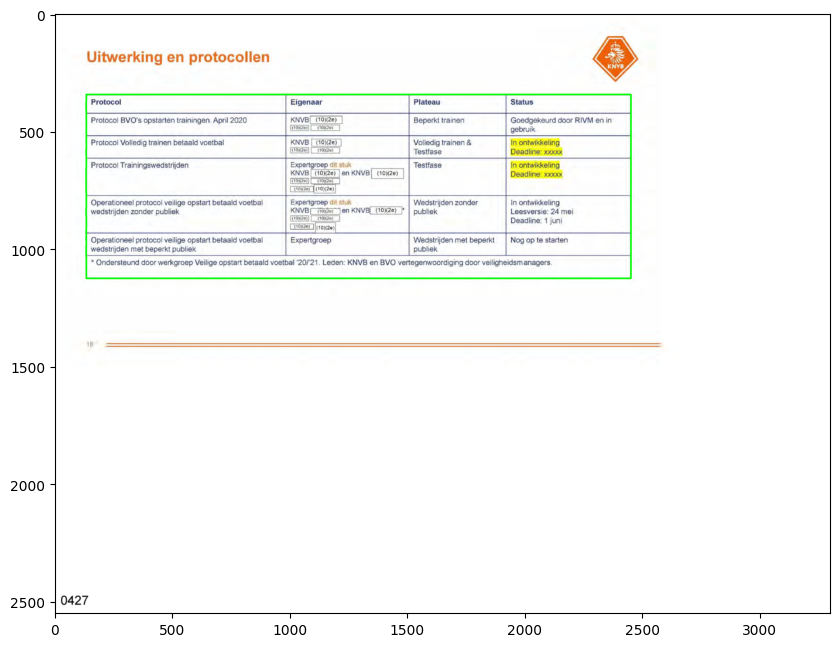

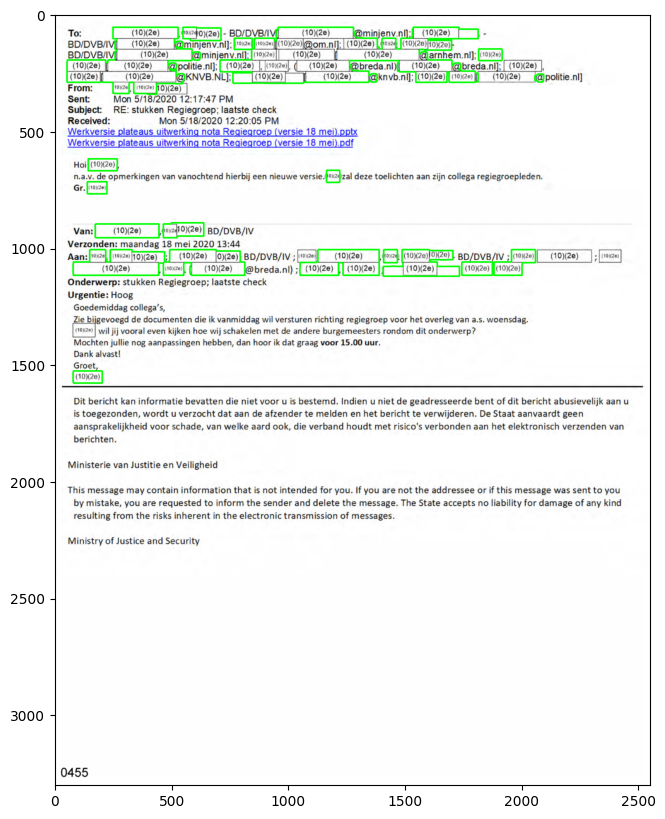

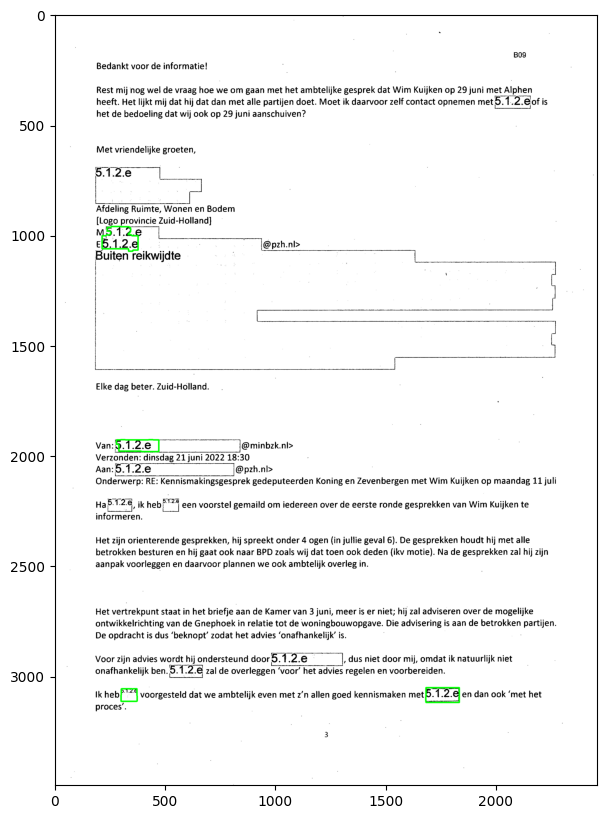

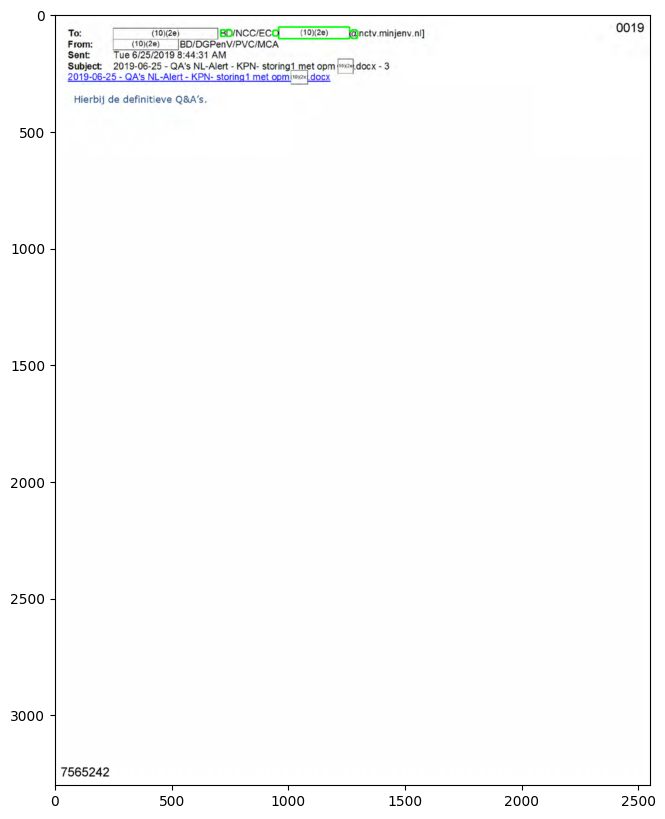

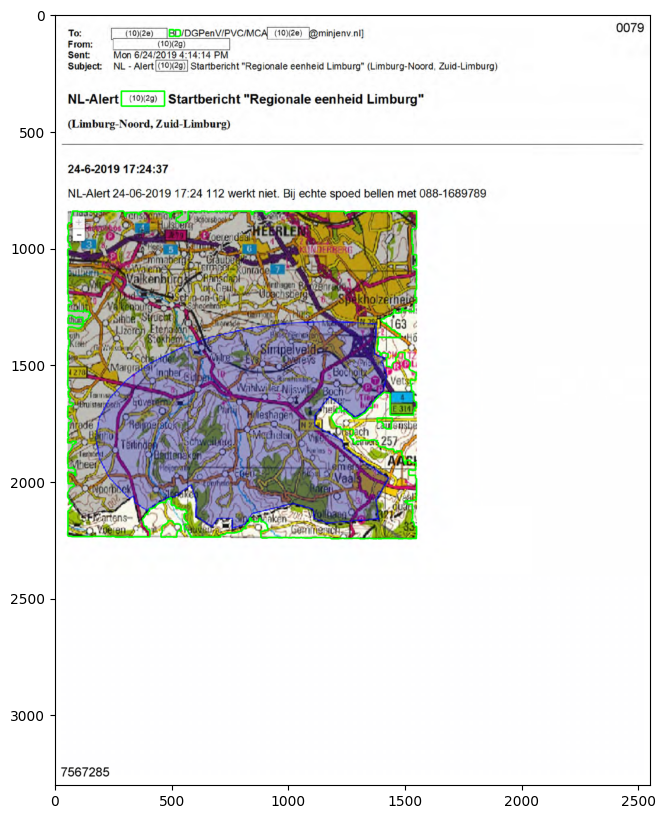

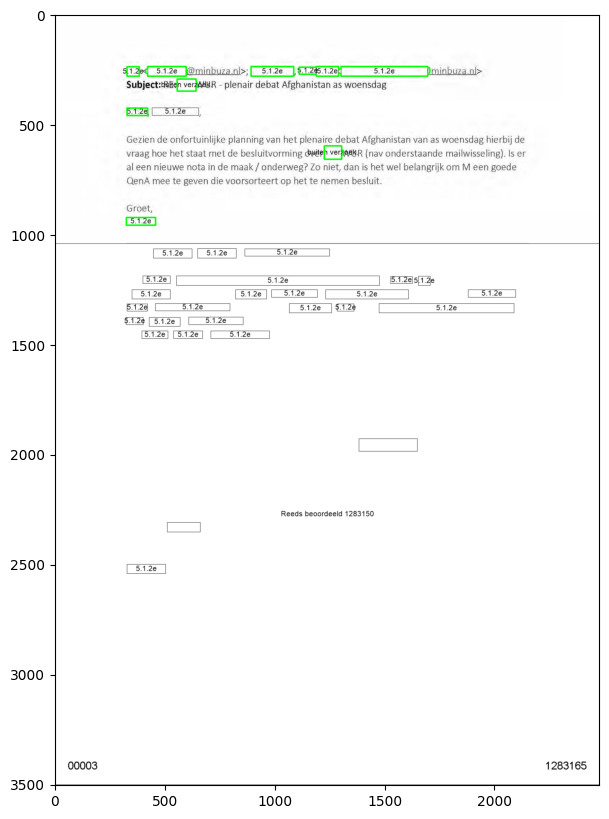

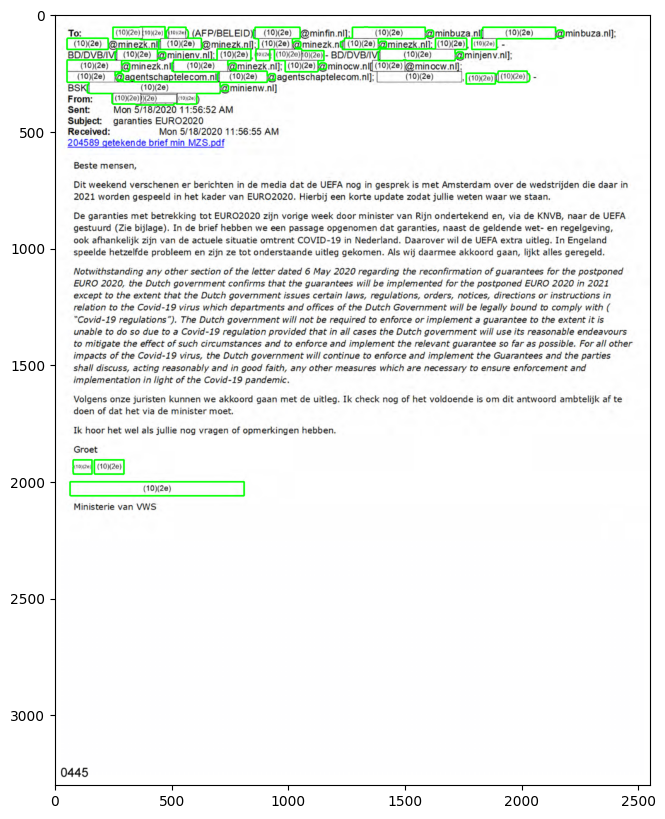

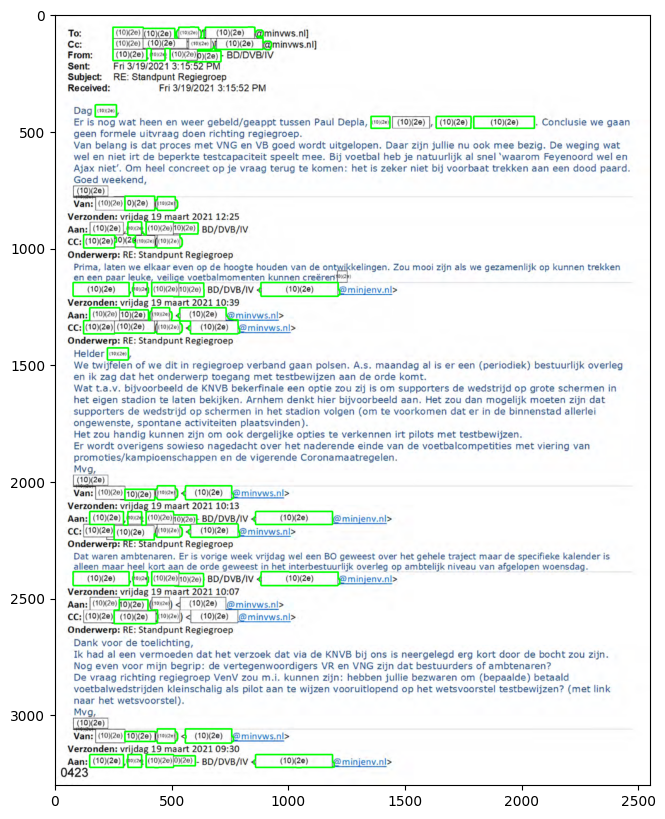

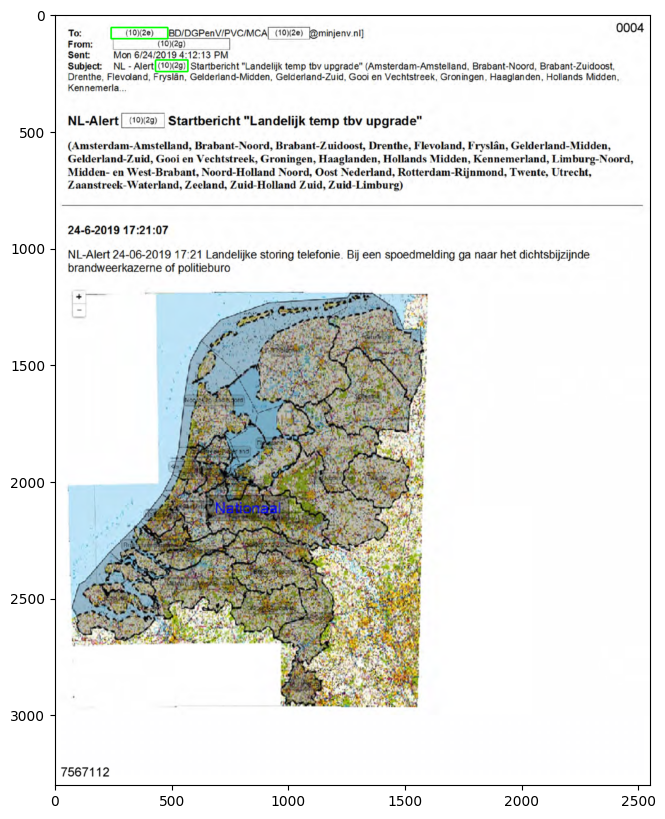

In [29]:
# show the images including predictions of the ocr model
show_ocr_results(poor_recall_border, 10)

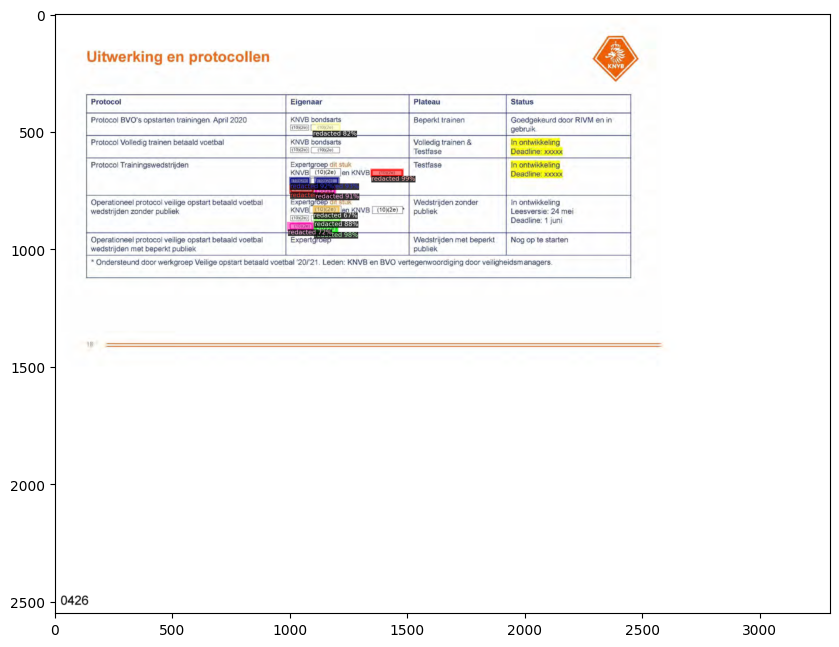

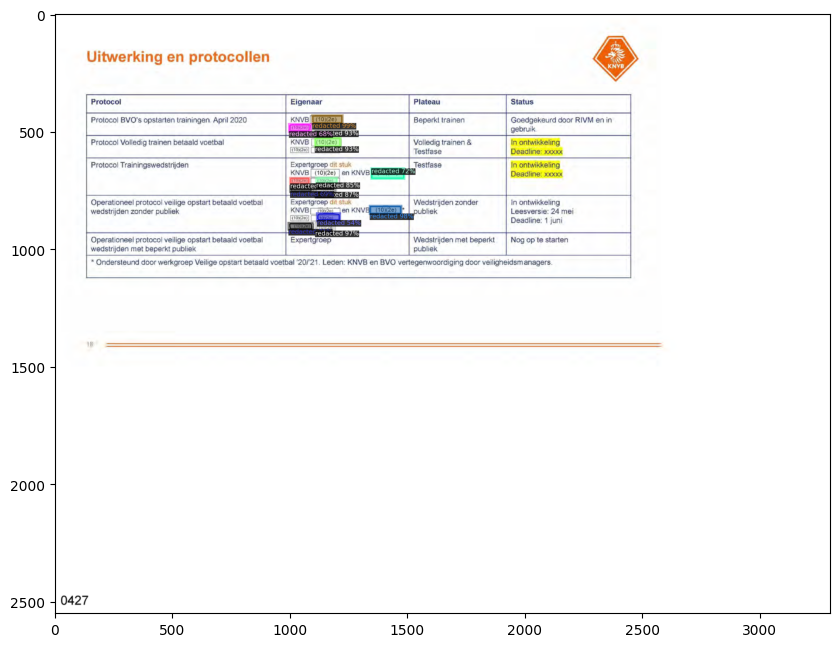

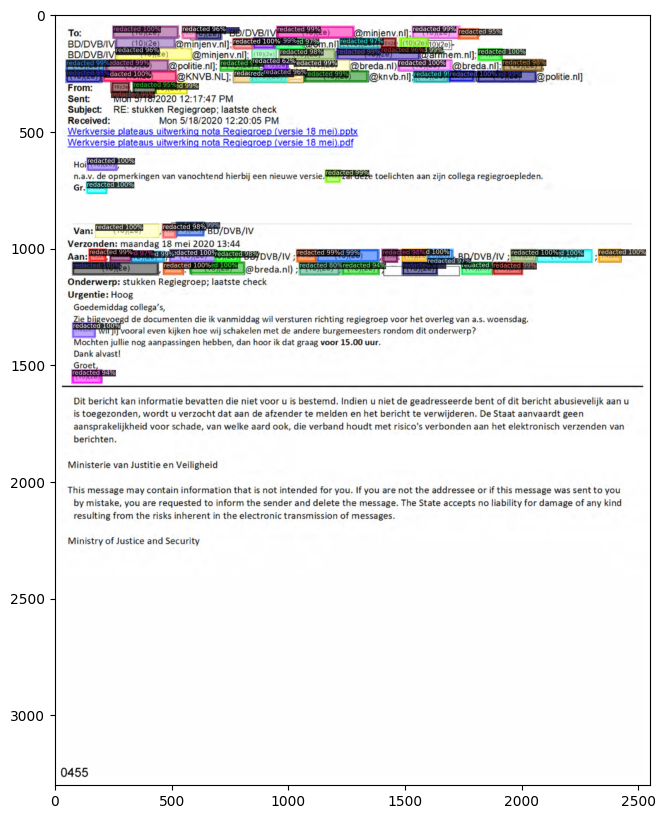

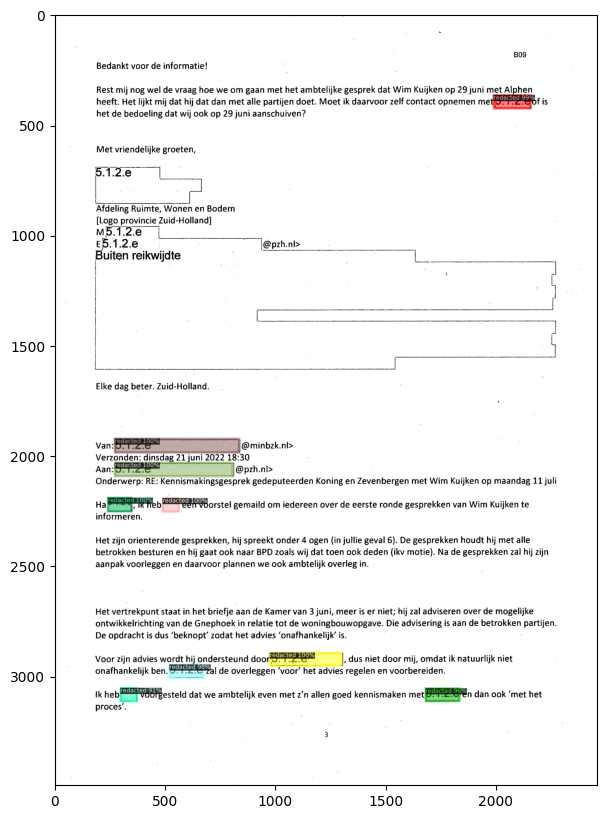

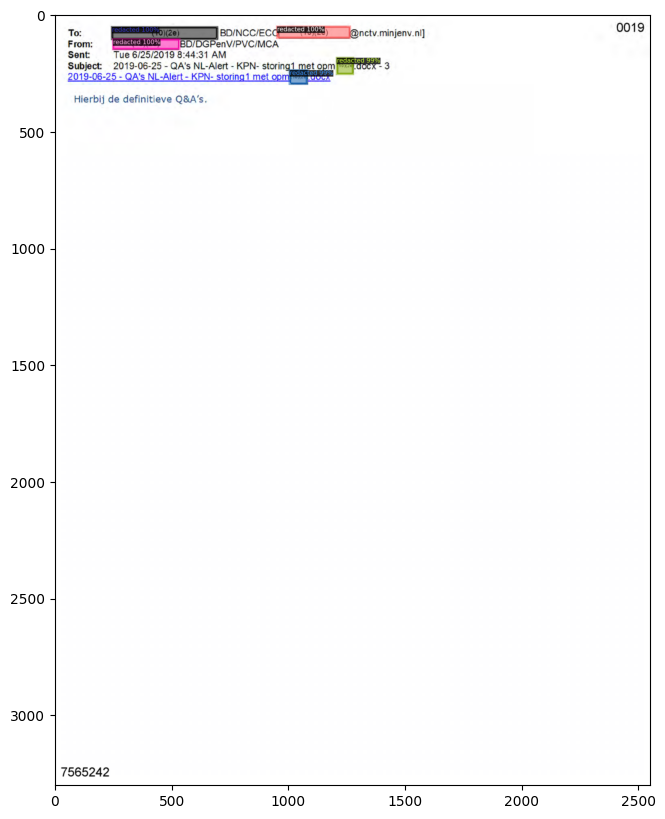

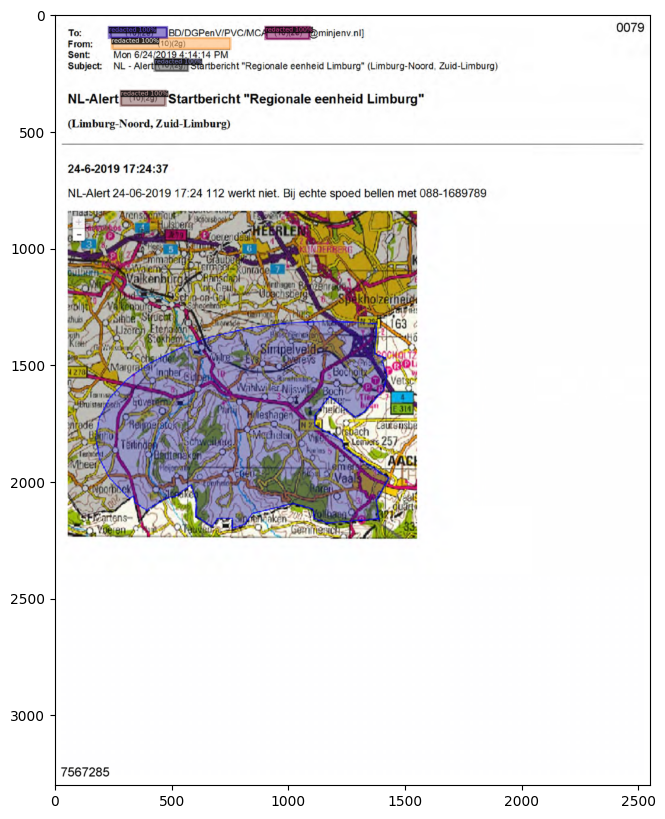

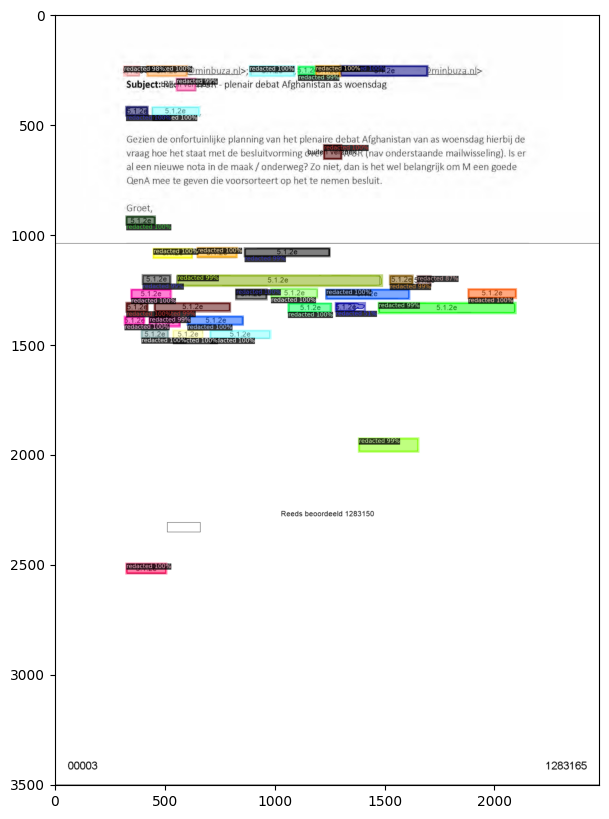

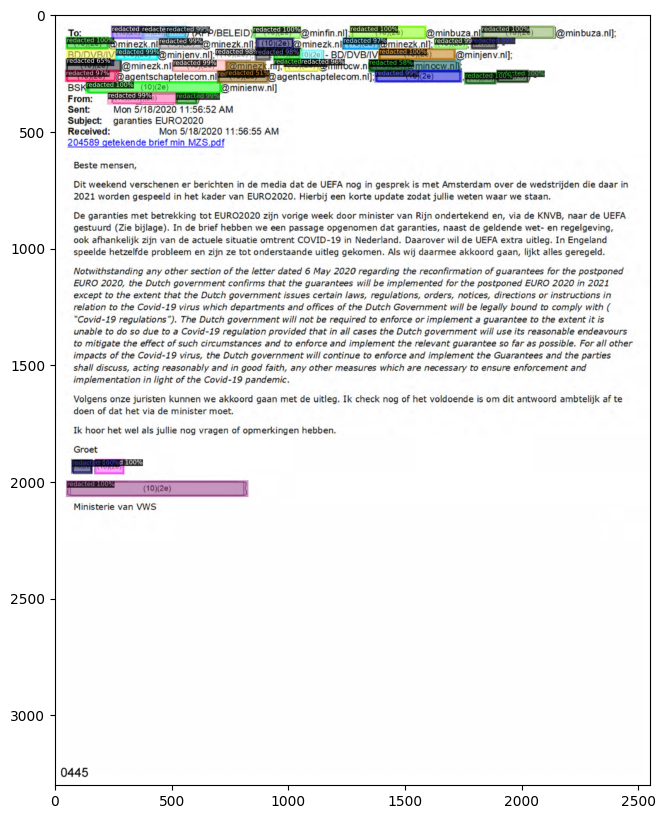

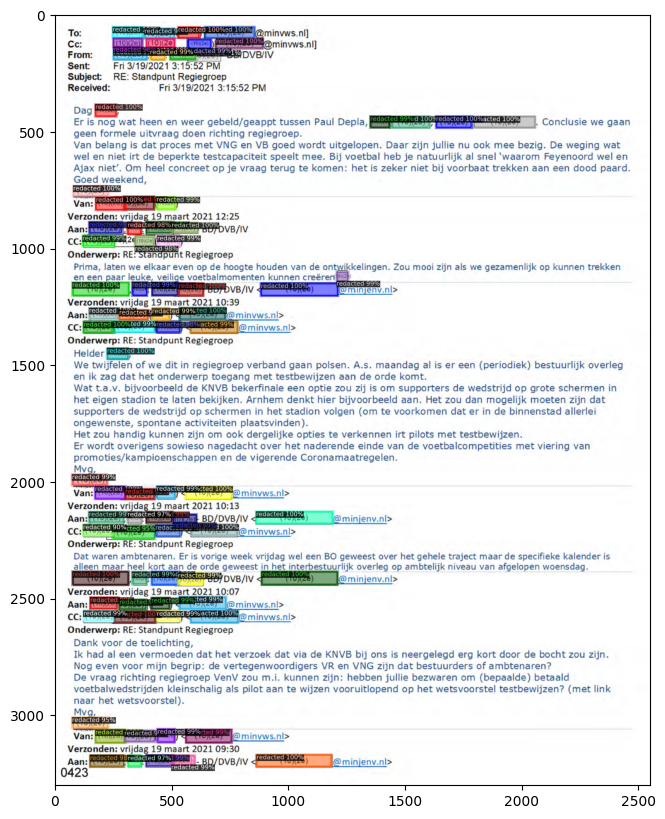

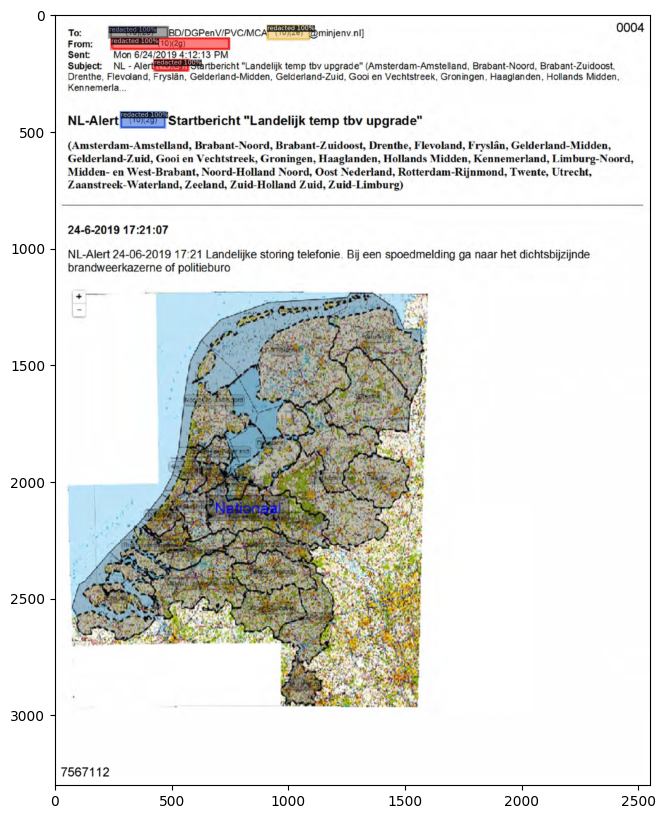

In [30]:
# show the images including predictions of the mask r-cnn model
show_maskrcnn_results(poor_recall_border, 10)

## Now gray redactions

In [31]:
# filter on the pages with gray redactions and sort by the lowest recall
# since these documents have the largest negatige effect on the recall of the ocr model
poor_recall_gray = ocr_complete[(ocr_complete['type'] == 'gray')].sort_values(by=['R'], ascending=True)
poor_recall_gray.head(10)

,TP,FP,FN,IOU,type,PQ,SQ,RQ,P,R
file,,,,,,,,,,
0007-page1.png,0,2,2,0.0,gray,0.0,0.0,0.0,0.0,0.0
Bijlagen bij besluit Woo-verzoek over verantwoord medicijngebruik-16.png,0,1,2,0.0,gray,0.0,0.0,0.0,0.0,0.0
Bijlagen bij besluit Woo-verzoek over verantwoord medicijngebruik-161.png,0,3,1,0.0,gray,0.0,0.0,0.0,0.0,0.0
Bijlagen bij besluit Woo-verzoek over verantwoord medicijngebruik-18.png,0,1,2,0.0,gray,0.0,0.0,0.0,0.0,0.0
Bijlagen bij besluit Woo-verzoek over verantwoord medicijngebruik-22.png,0,1,1,0.0,gray,0.0,0.0,0.0,0.0,0.0
Bijlagen bij besluit Woo-verzoek over verantwoord medicijngebruik-75.png,0,6,1,0.0,gray,0.0,0.0,0.0,0.0,0.0
Bijlagen bij besluit Woo-verzoek over verantwoord medicijngebruik-79.png,0,1,1,0.0,gray,0.0,0.0,0.0,0.0,0.0
Bijlagen bij besluit Woo-verzoek over verantwoord medicijngebruik-147.png,0,3,1,0.0,gray,0.0,0.0,0.0,0.0,0.0
c-sms-berichten-mp-sg-26.png,0,3,1,0.0,gray,0.0,0.0,0.0,0.0,0.0


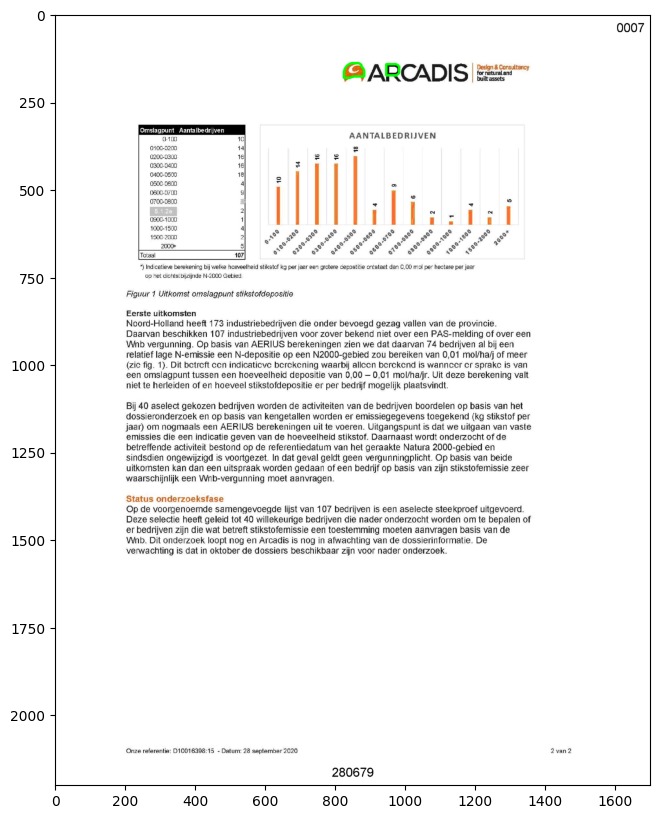

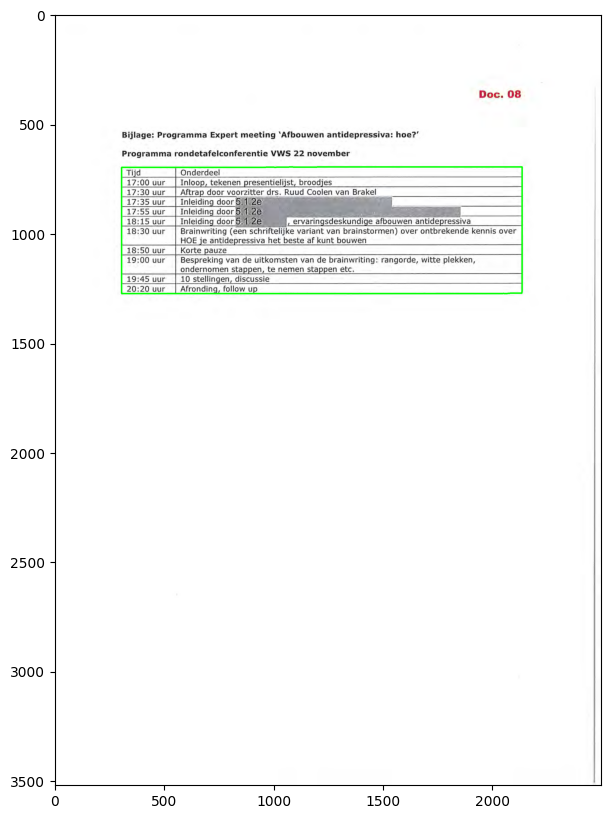

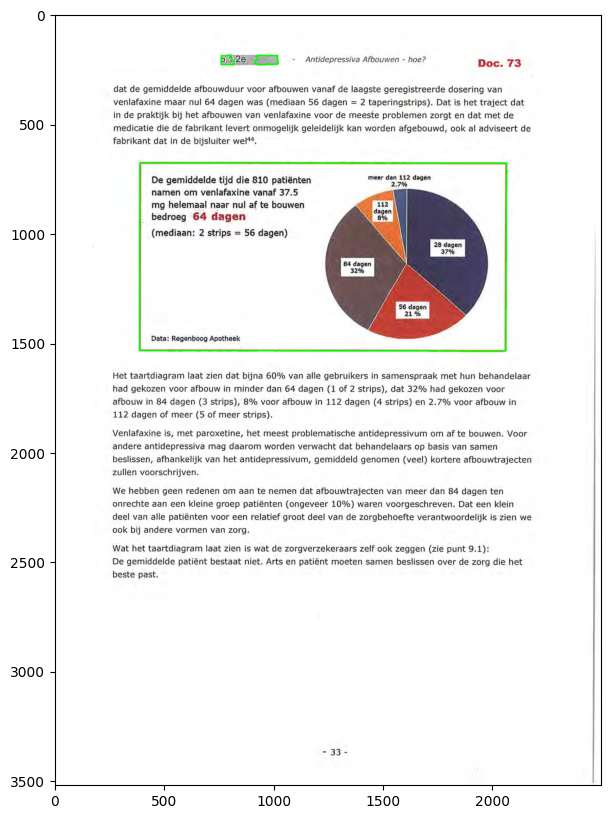

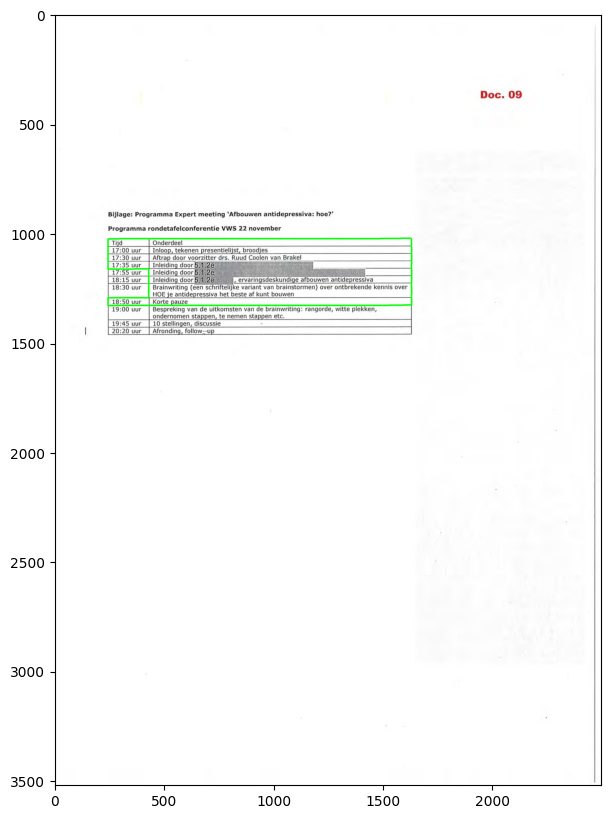

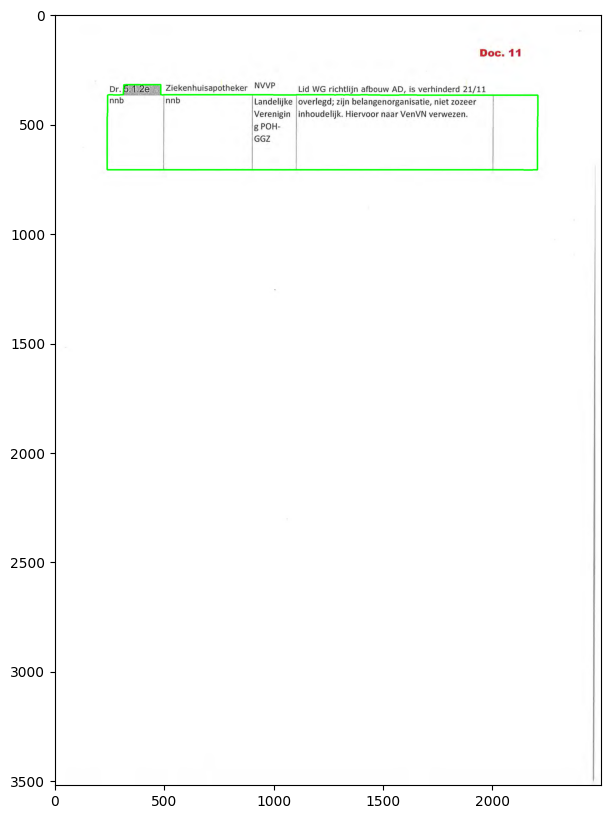

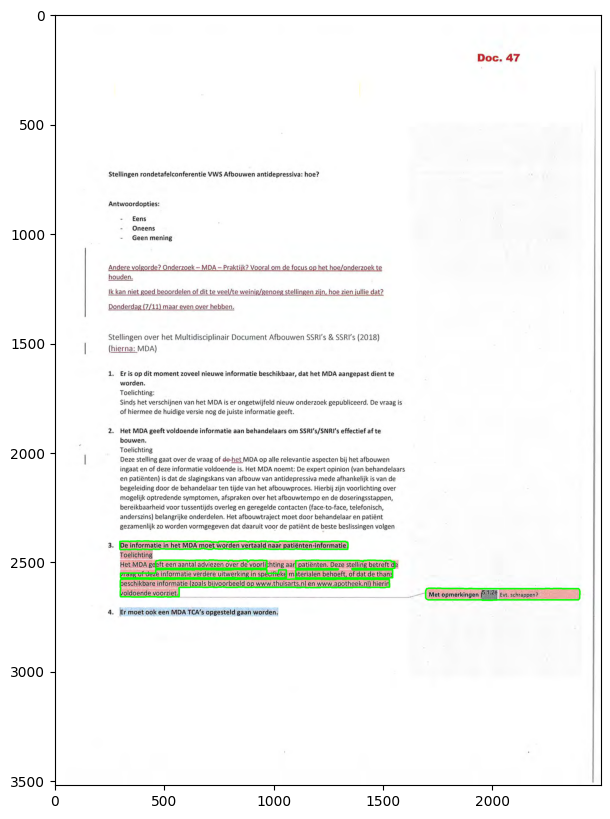

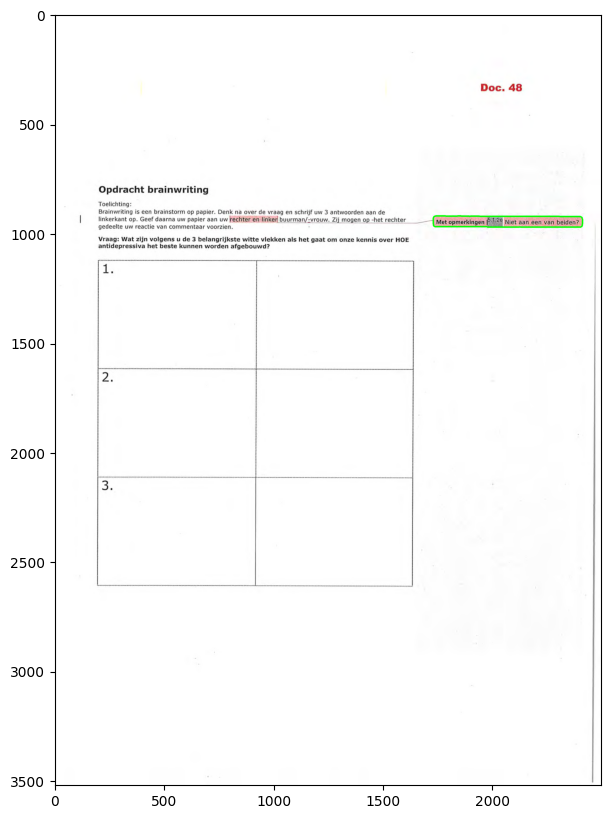

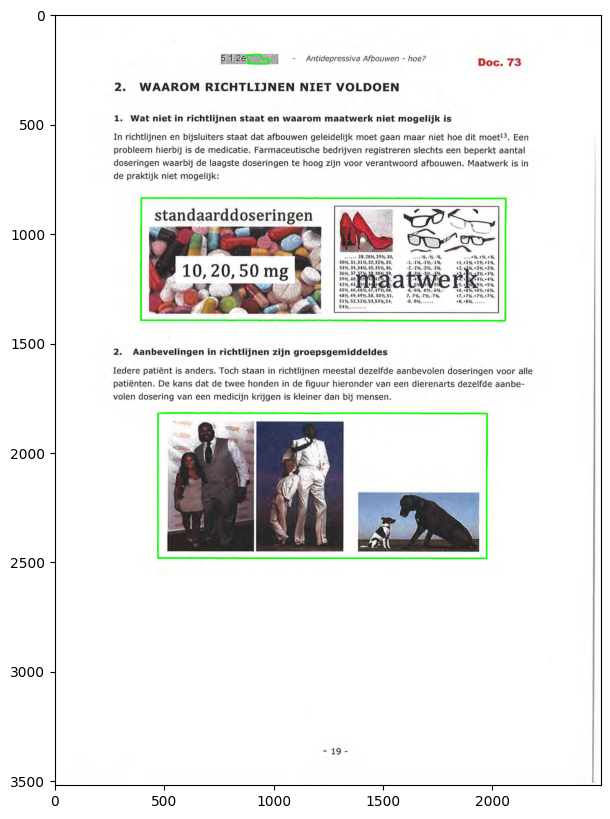

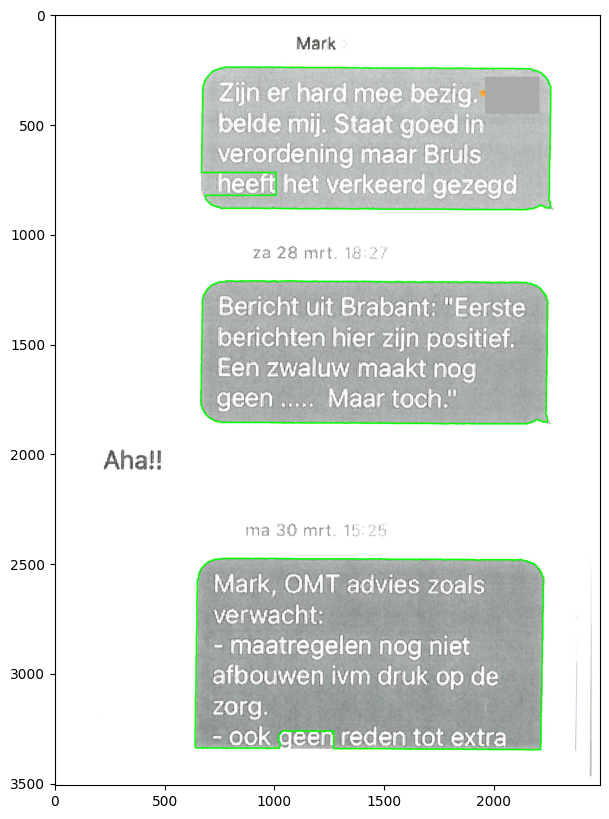

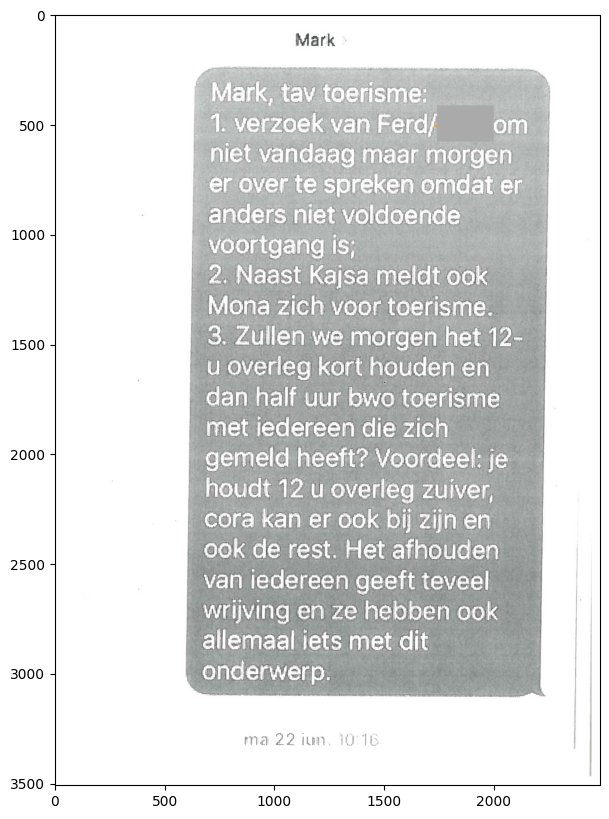

In [32]:
# show the images including predictions of the ocr model
show_ocr_results(poor_recall_gray, 10)

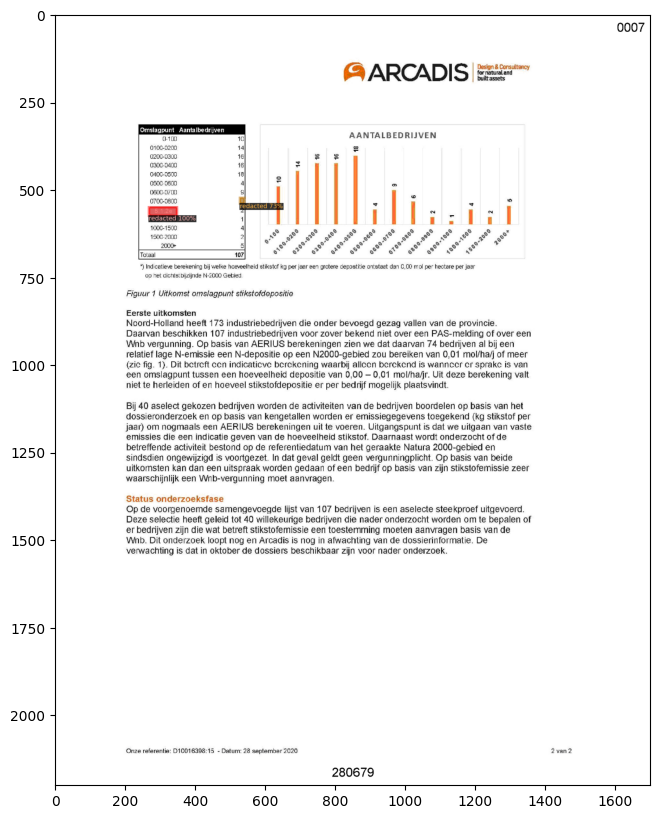

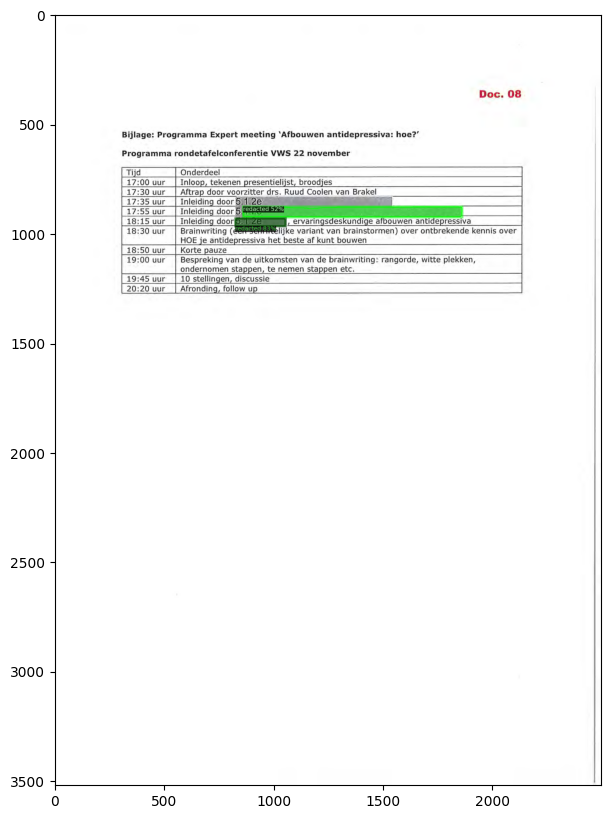

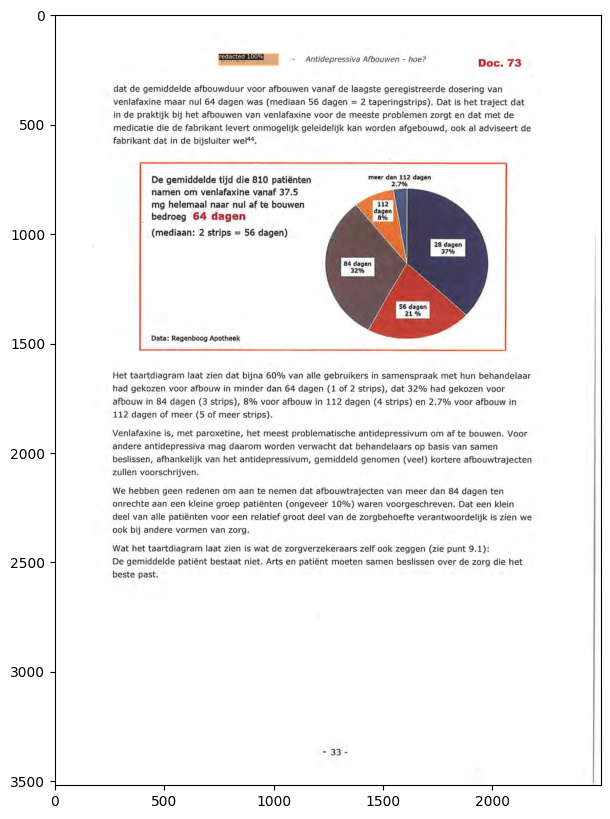

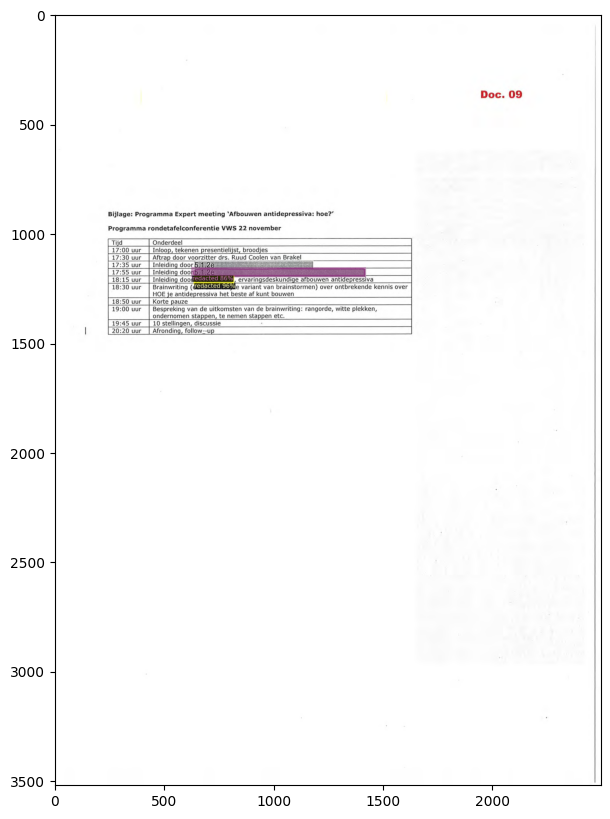

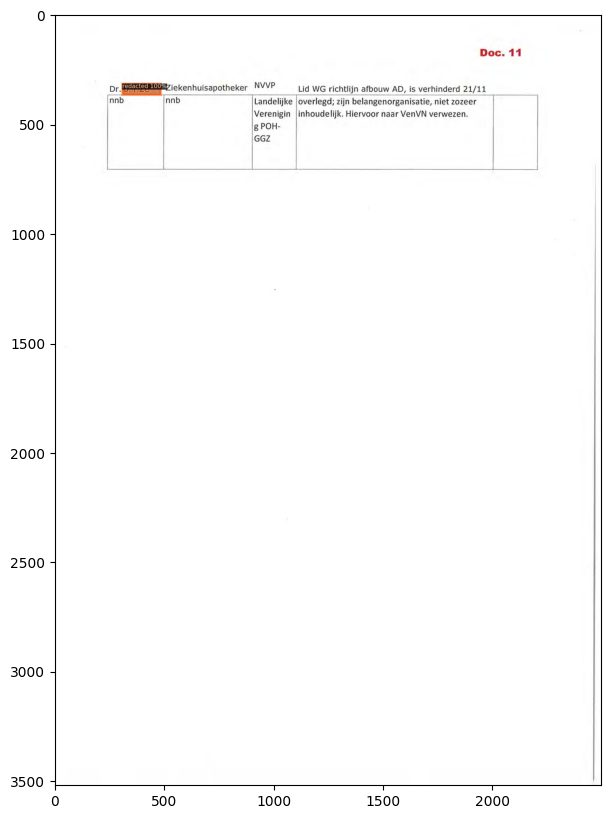

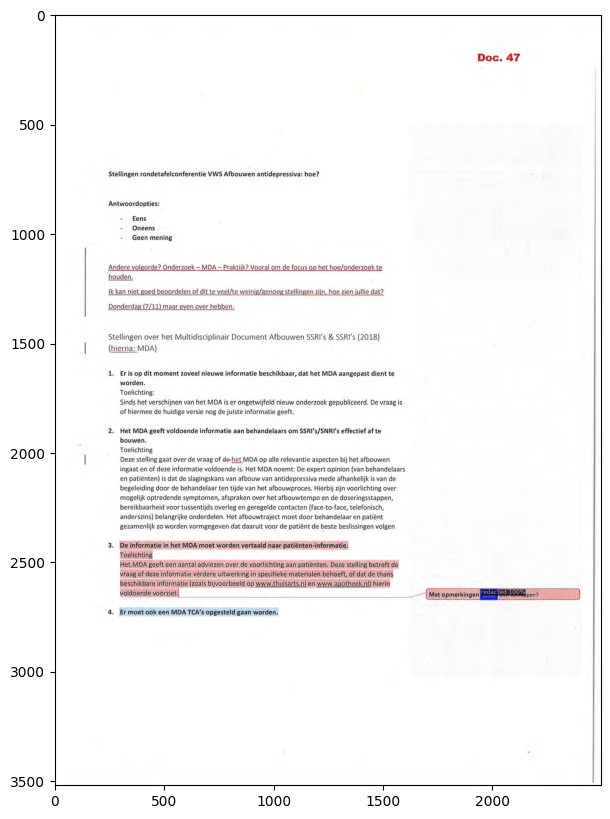

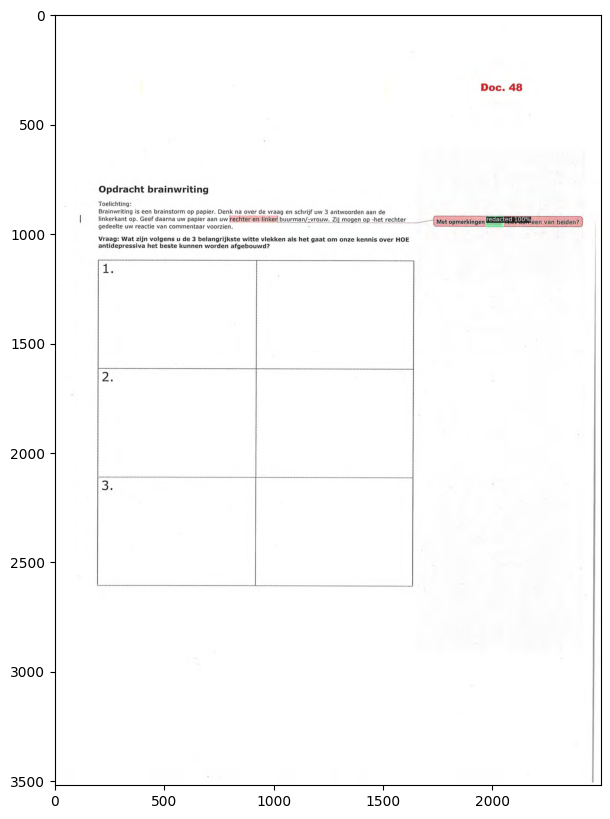

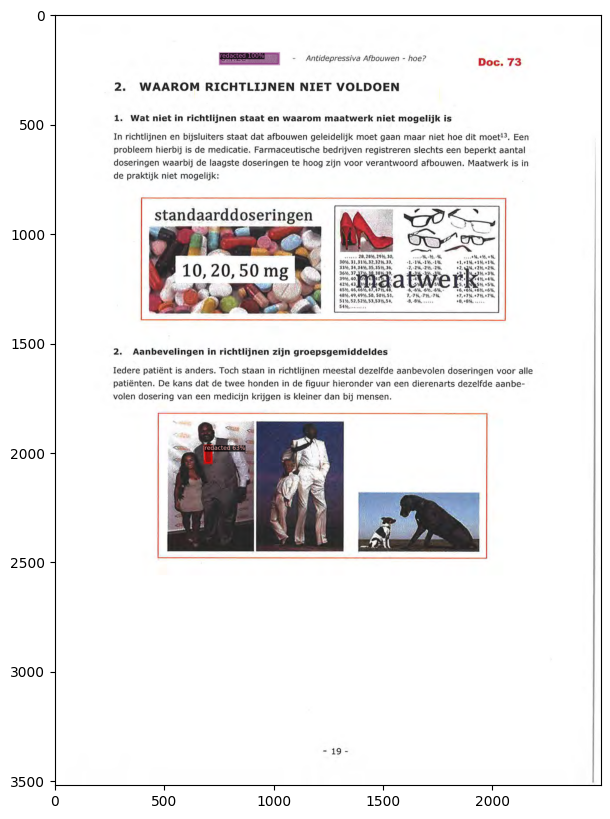

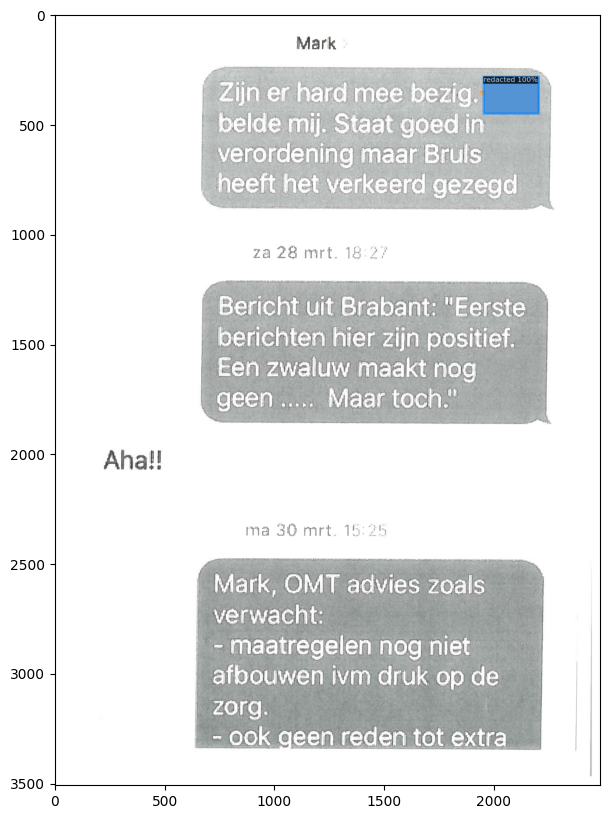

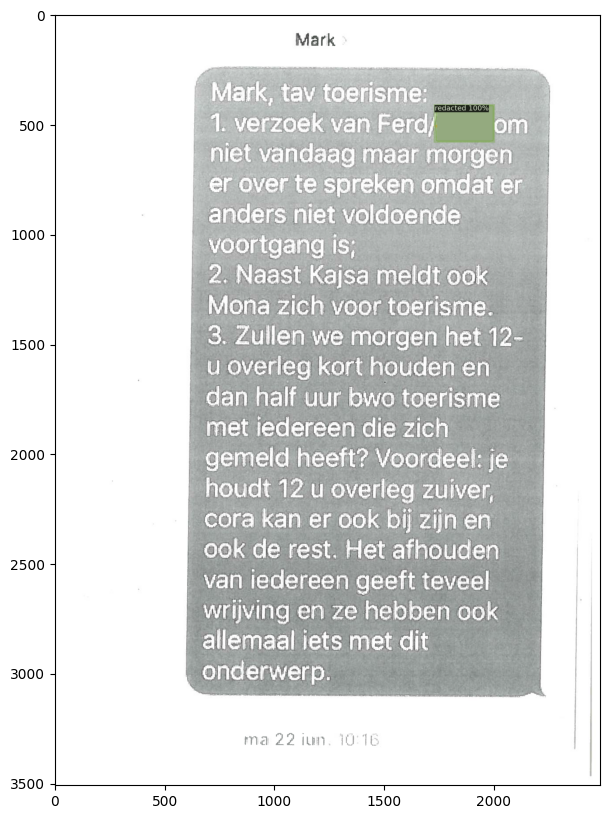

In [33]:
# show the images including predictions of the mask r-cnn model
show_maskrcnn_results(poor_recall_gray, 10)

I noticed from the head of the DataFrame that all these documents only have 1 or 2 redactions per page. These pages will have a small effect on the total recall of the model, so I will filter on pages with at least x redactions per page.

In [34]:
# filter on the pages with gray redactions and sort by the lowest recall and at least 3 redactions
# since these documents have the largest negatige effect on the recall of the ocr model
poor_recall_gray = ocr_complete[(ocr_complete['TP'] + ocr_complete['FN'] > 3) &
                                (ocr_complete['type'] == 'gray')].sort_values(by=['R'], ascending=True)
poor_recall_gray.head(10)

,TP,FP,FN,IOU,type,PQ,SQ,RQ,P,R
file,,,,,,,,,,
0011-page0.png,0,2,15,0.0,gray,0.00,0.00,0.00,0.00,0.00
Gelakte stukken Wob-verzoek omgevingsproces Ternaard 2e deel-160.png,0,2,4,0.0,gray,0.00,0.00,0.00,0.00,0.00
c-sms-berichten-mp-sg-7.png,0,0,4,0.0,gray,0.00,0.00,0.00,0.00,0.00
documenten-180-226-81.png,3,5,31,2.436963,gray,0.12,0.81,0.14,0.38,0.09
Bijlagen bij besluit Woo-verzoek over verantwoord medicijngebruik-3.png,2,0,17,1.479029,gray,0.14,0.74,0.19,1.00,0.11
documenten-180-226-61.png,6,15,42,5.254998,gray,0.15,0.88,0.17,0.29,0.12
Gelakte stukken Wob-verzoek omgevingsproces Ternaard 2e deel-45.png,5,2,17,4.166172,gray,0.29,0.83,0.34,0.71,0.23
documenten-180-226-45.png,5,2,17,3.992901,gray,0.28,0.80,0.34,0.71,0.23
documenten-180-226-22.png,2,2,5,1.766157,gray,0.32,0.88,0.36,0.50,0.29


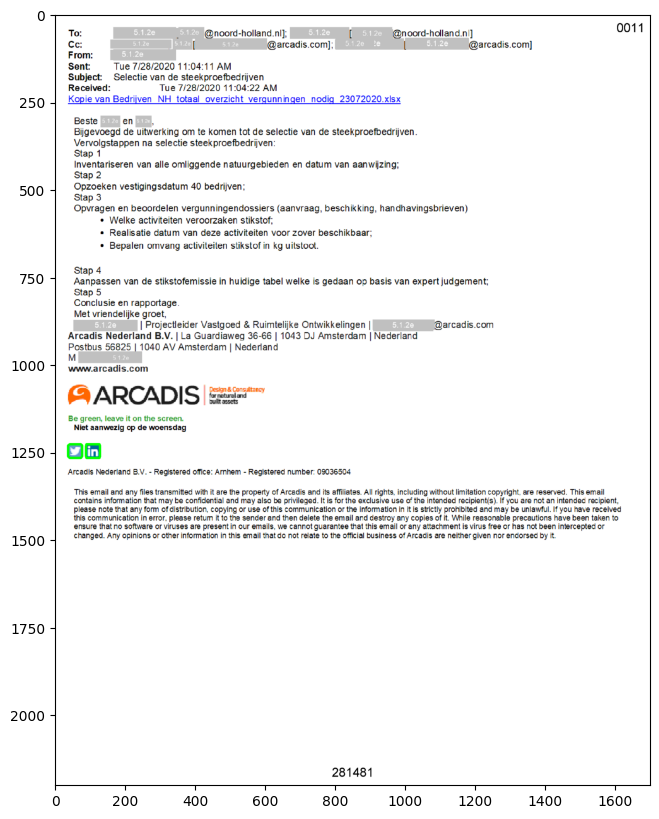

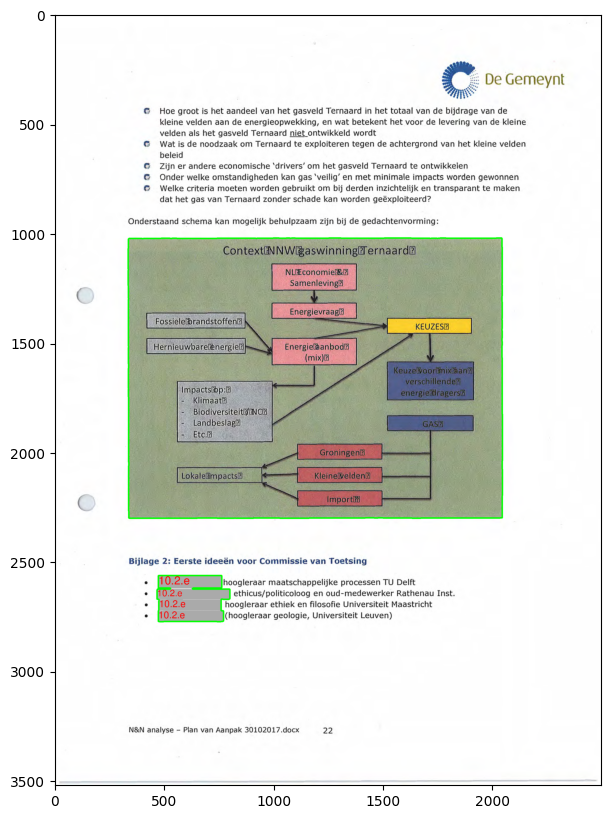

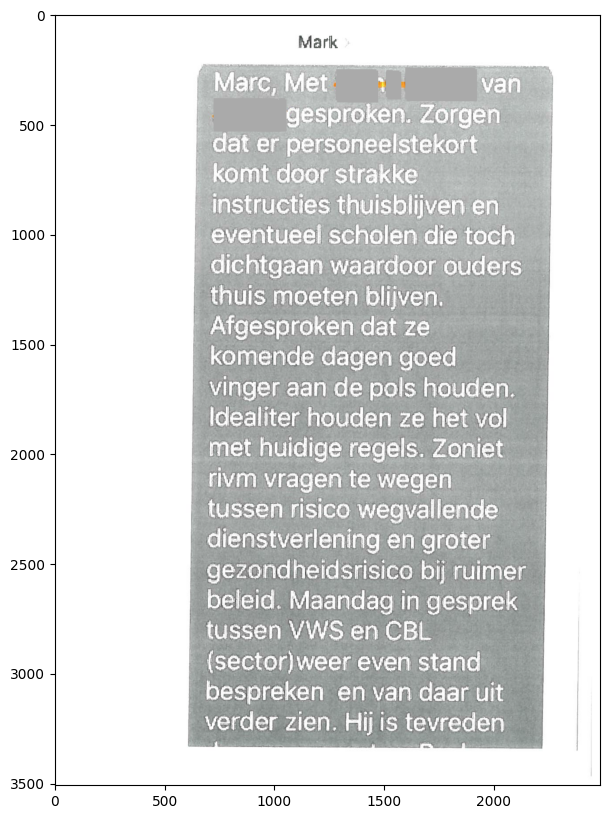

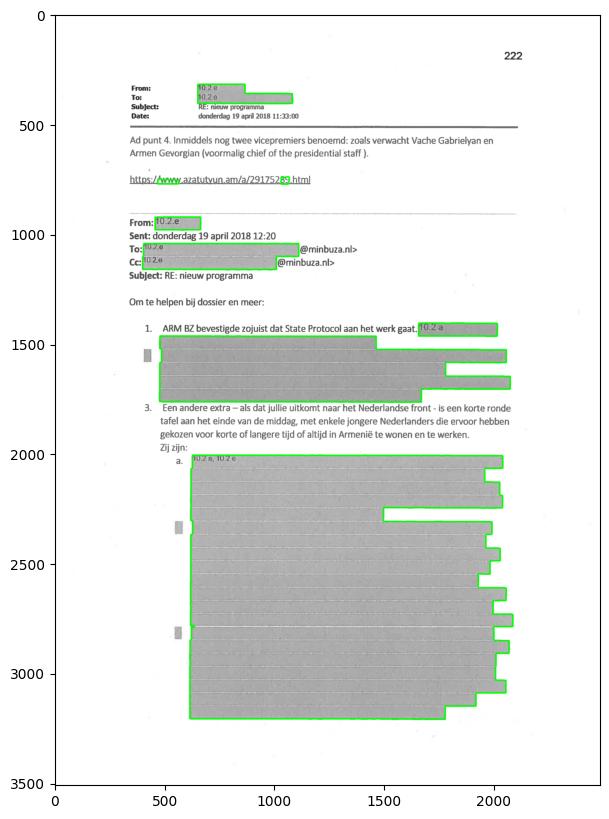

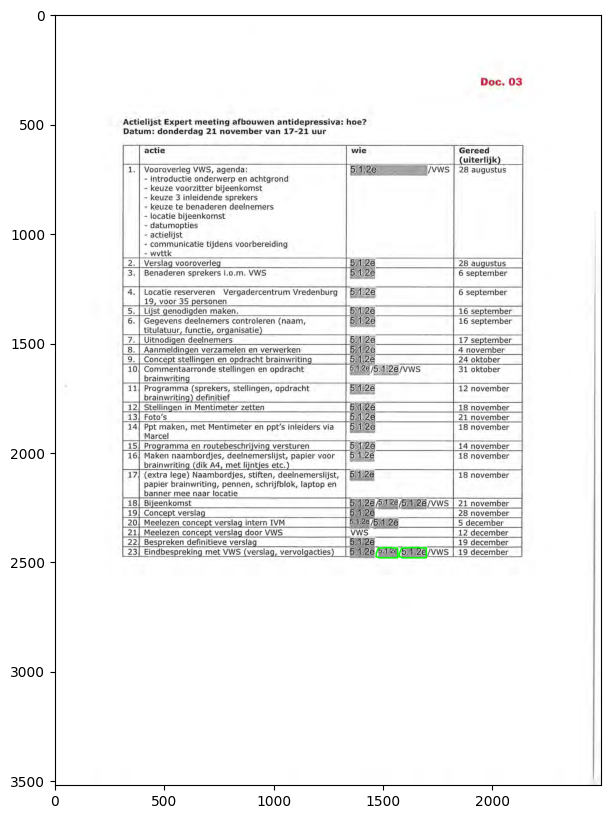

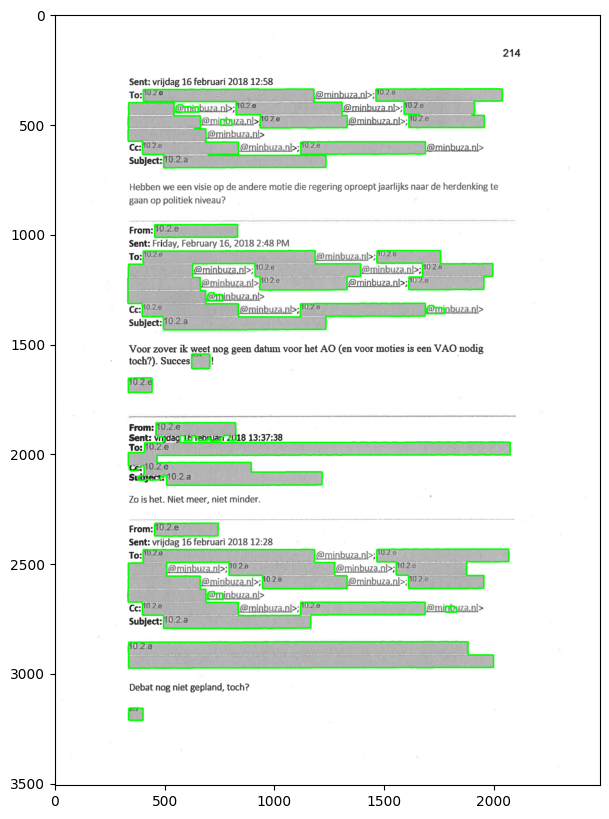

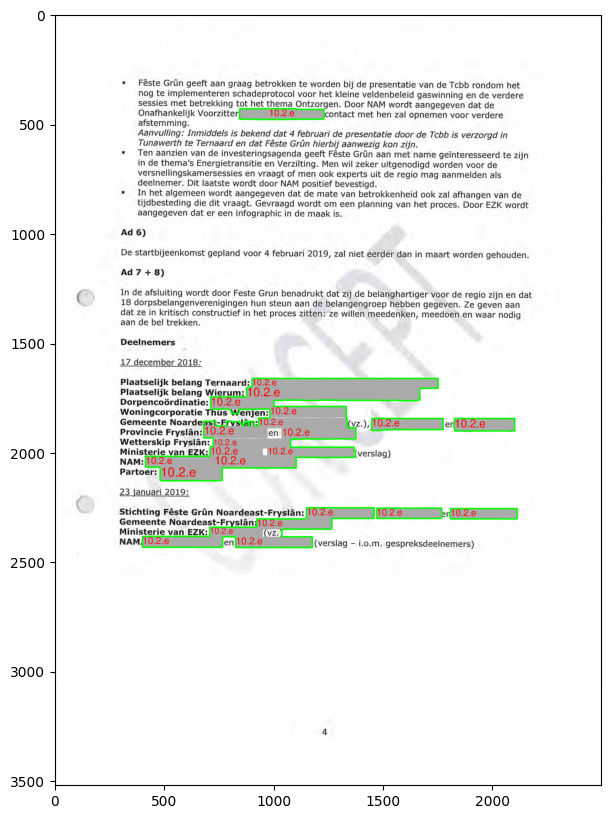

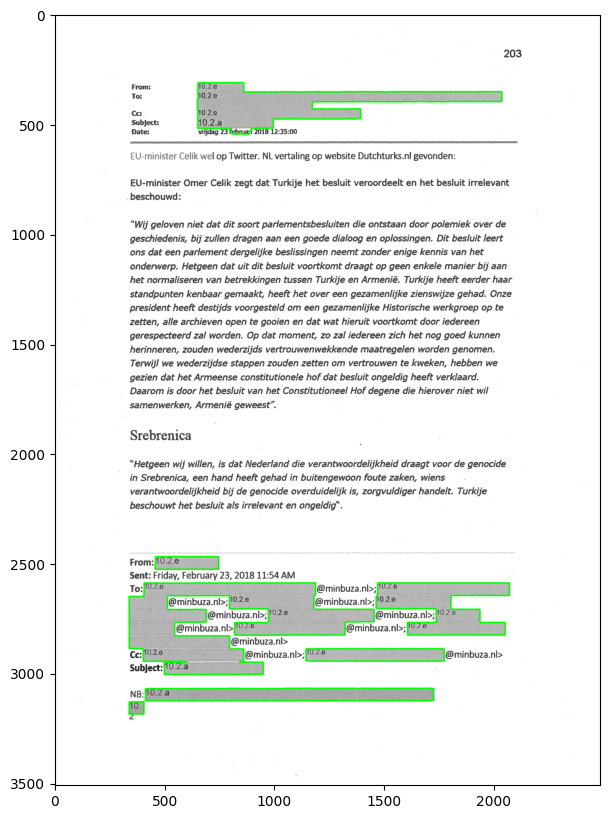

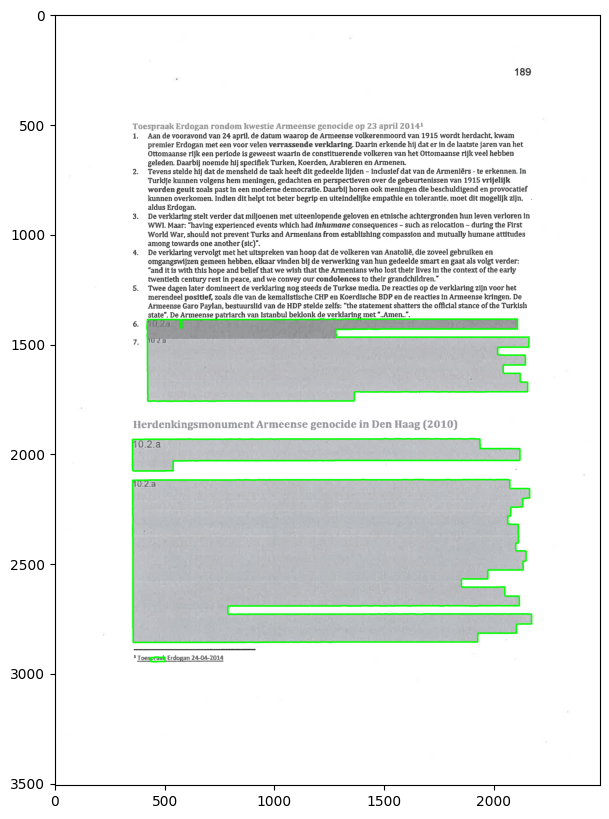

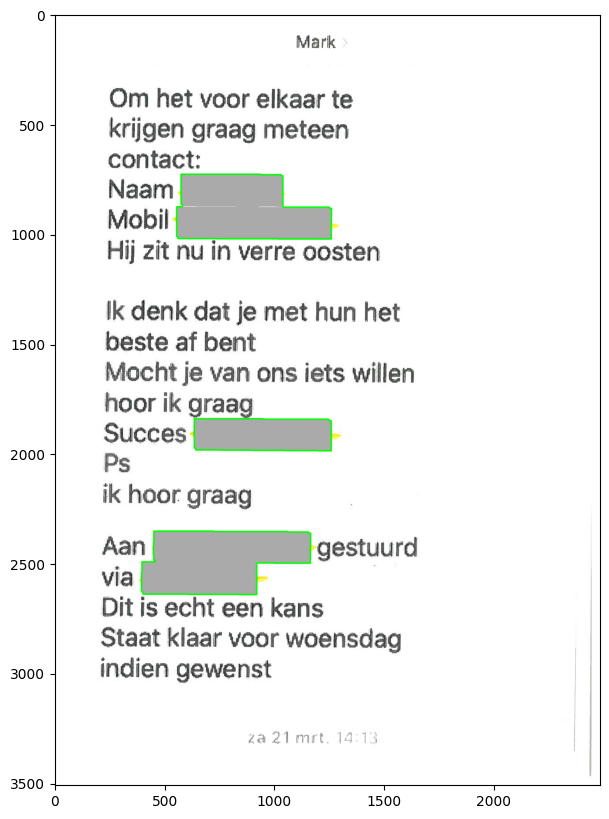

In [35]:
## show the images including predictions of the ocr model
show_ocr_results(poor_recall_gray, 10)

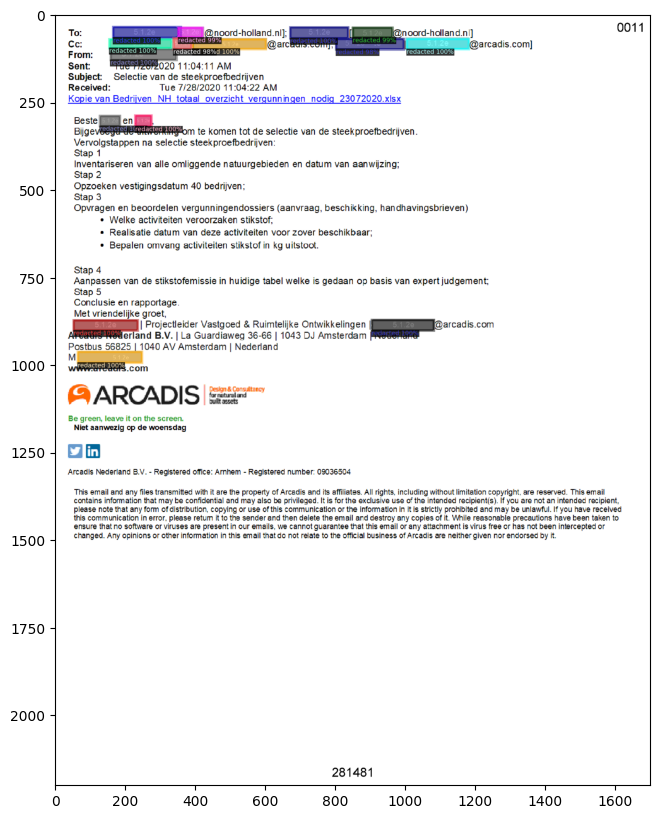

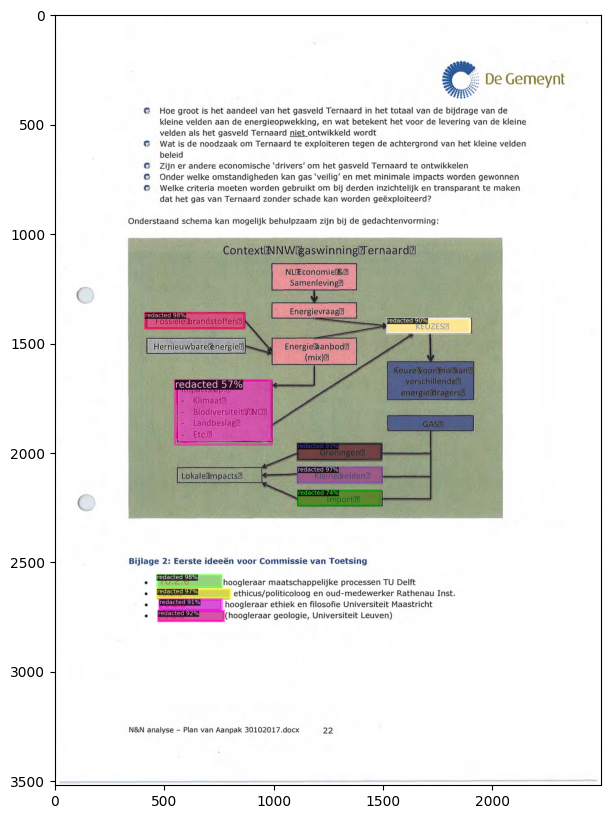

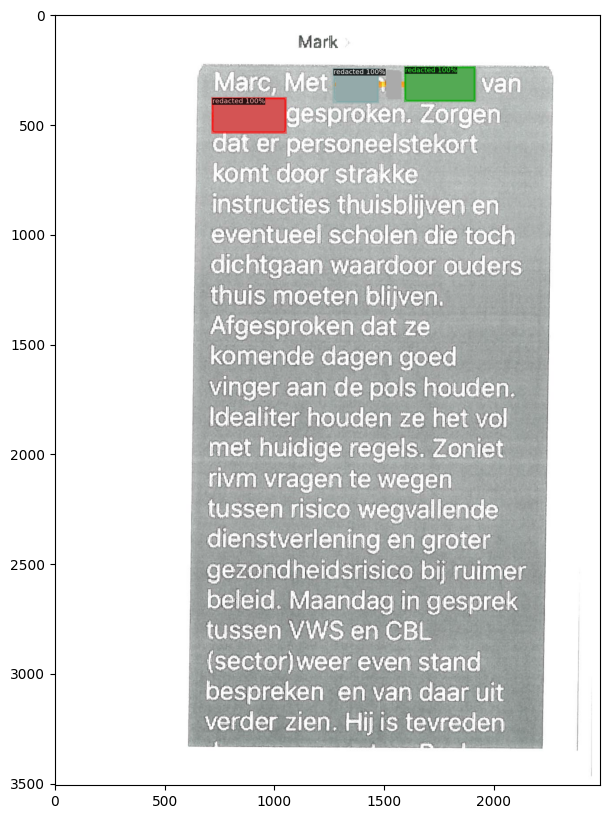

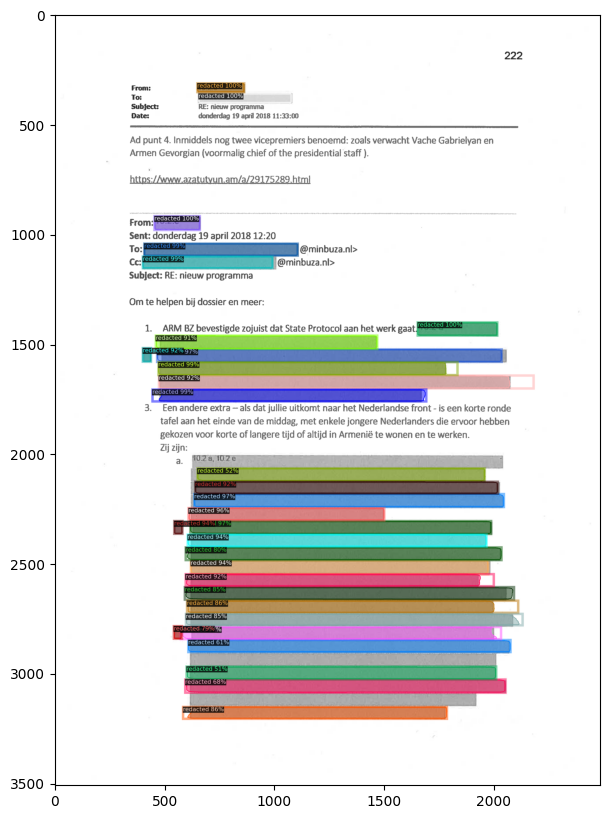

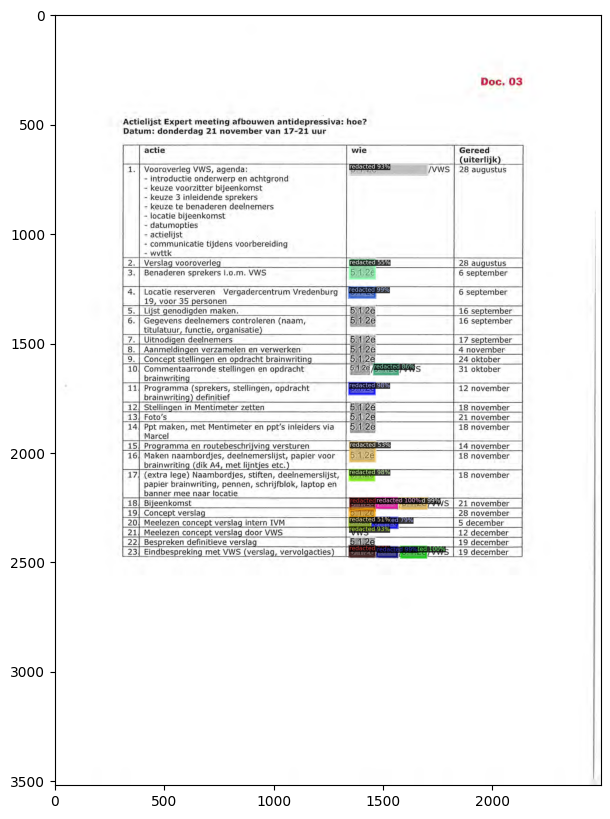

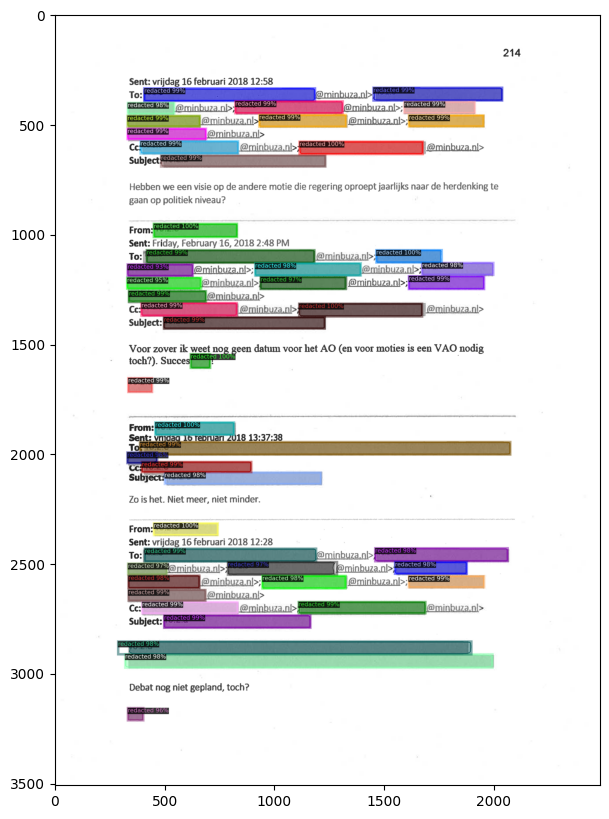

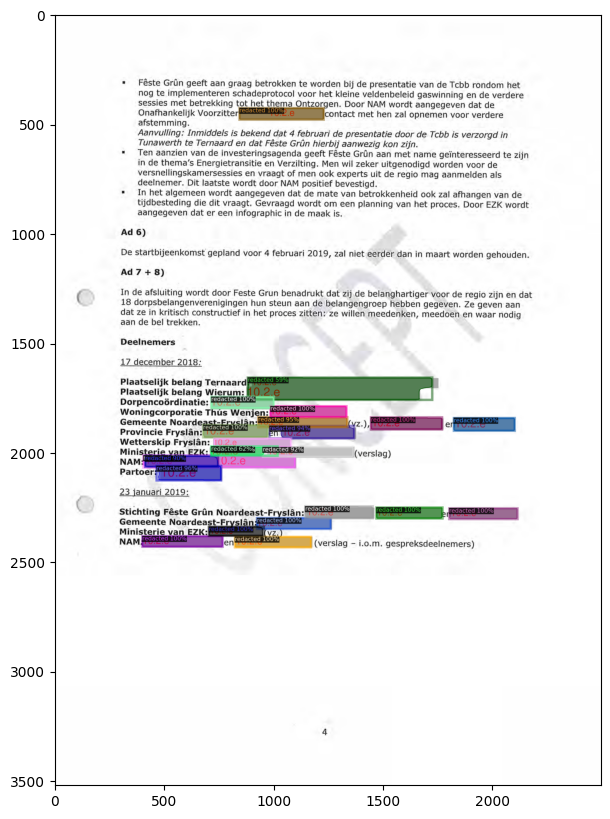

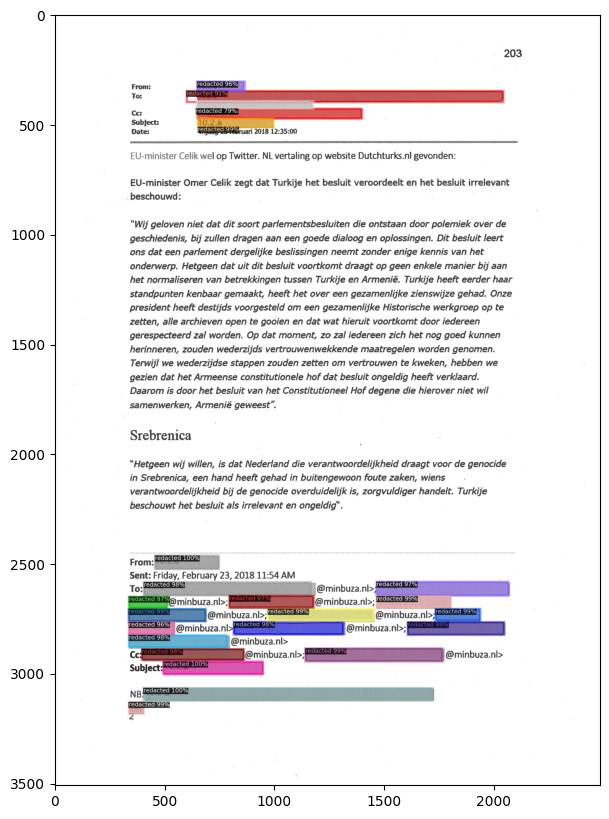

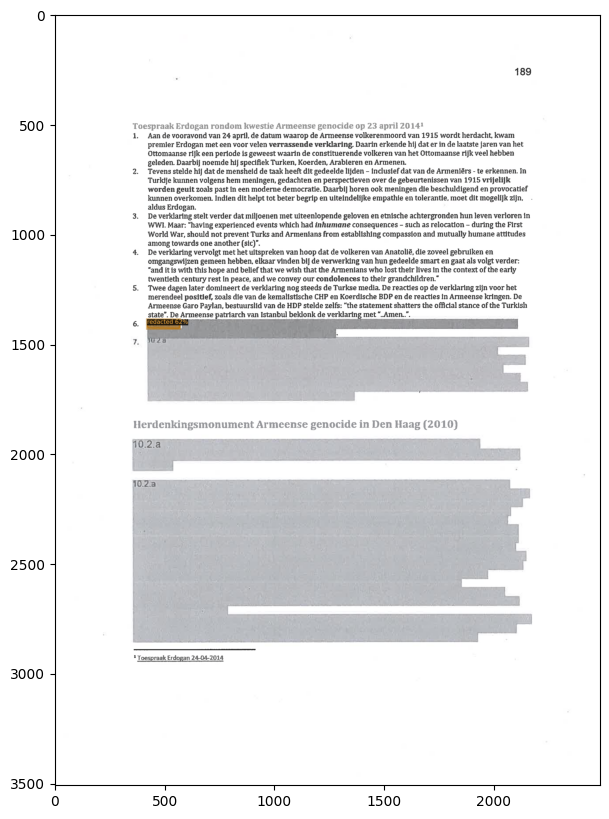

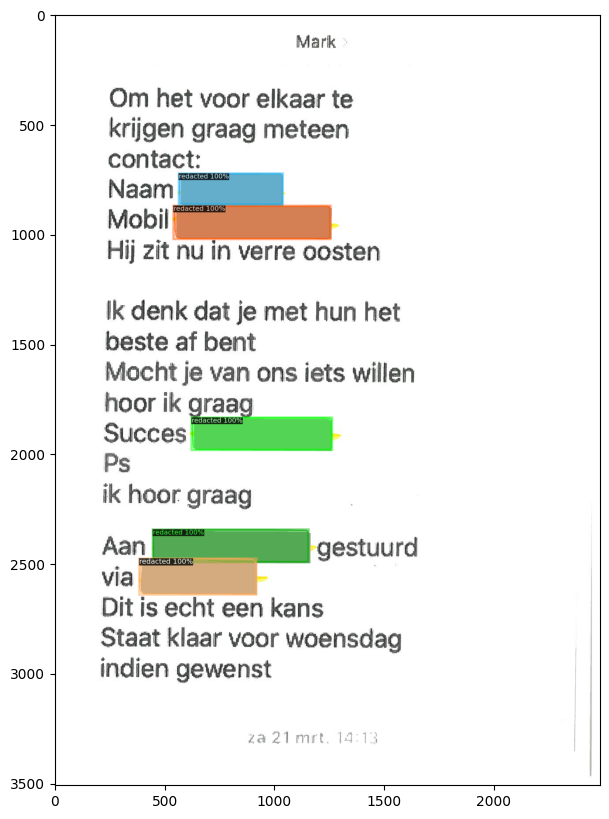

In [36]:
# show the images including predictions of the mask r-cnn model
show_maskrcnn_results(poor_recall_gray, 10)

# Analyse pages without annotation with the most false positives

In [37]:
print(maskrcnn_no_annotations['FP'].mean(), maskrcnn_no_annotations['FP'].std())
print(ocr_no_annotations['FP'].mean(), ocr_no_annotations['FP'].std())

1.3096774193548386 3.6029708916275434
8.180645161290322 13.930938644941197


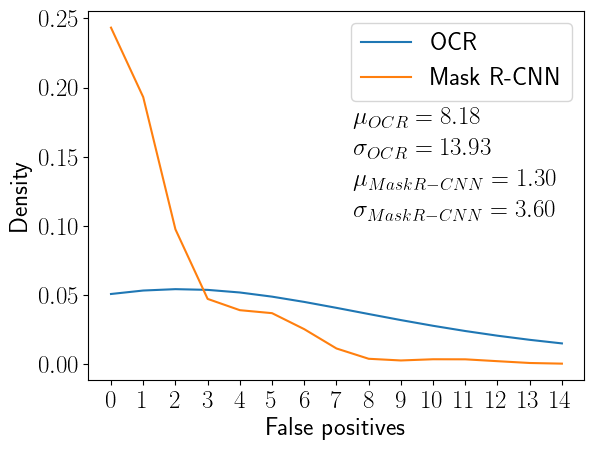

In [38]:
# import matplotlib so that the text can use
# the latex formatting
import matplotlib as mpl
mpl.rc('text', usetex=True)

FP_df = pd.DataFrame({
    'OCR': ocr_no_annotations['FP'],
    'Mask R-CNN': maskrcnn_no_annotations['FP'],
})
FP_df.plot.kde(ind=range(0, 15))
plt.yticks(fontsize = 18)
plt.xticks(range(0, 15), fontsize = 18)
plt.legend(prop={'size': 18})
plt.ylabel('Density', fontsize = 18)
plt.xlabel('False positives', fontsize = 18)

# add a table to the figure
# table = r'''\begin{tabular}{ r | c c } & Mean & Standard deviation \\\hline OCR & 8.18 & 13.93 \\ Mask R-CNN & 1.23 & 3.42 \end{tabular}'''
# text = r'''$\mu_{OCR}=8.18$\\$\sigma_{OCR}=13.93$\\$\mu_{Mask R-CNN}=1.23$\\$\sigma_{Mask R-CNN}=3.42$'''
table = r'''\begin{tabular}{l}$\mu_{OCR}=8.18$\\$\sigma_{OCR}=13.93$\\$\mu_{Mask R-CNN}=1.30$\\$\sigma_{Mask R-CNN}=3.60$ \end{tabular}'''
_ = plt.text(7.5,.14,table,size=18)

In [39]:
print(maskrcnn_no_annotations['Ratio redacted area'].mean(), maskrcnn_no_annotations['Ratio redacted area'].std())
print(ocr_no_annotations['Ratio redacted area'].mean(), ocr_no_annotations['Ratio redacted area'].std())

0.038463515775202885 0.07999830878894588
0.06741457324581632 0.13153758367180934


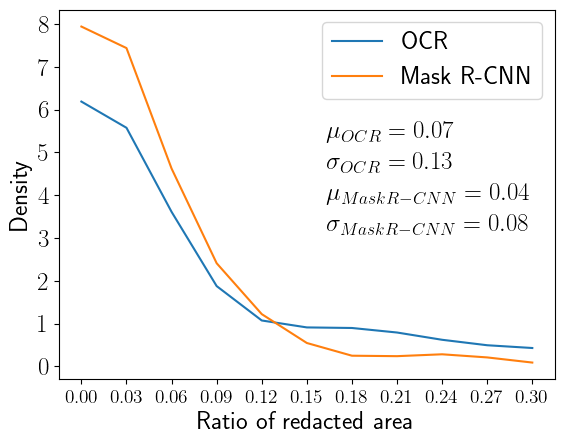

In [40]:
area_df = pd.DataFrame({
    'OCR': ocr_no_annotations['Ratio redacted area'],
    'Mask R-CNN': maskrcnn_no_annotations['Ratio redacted area'],
})
area_df.plot.kde(ind=np.linspace(0,0.3,11))
plt.yticks(fontsize = 18)
plt.xticks(np.linspace(0,0.3,11), fontsize = 14)
plt.legend(prop={'size': 18})
plt.ylabel('Density', fontsize = 18)
plt.xlabel('Ratio of redacted area', fontsize = 18)

table = r'''\begin{tabular}{l}$\mu_{OCR}=0.07$\\$\sigma_{OCR}=0.13$\\$\mu_{Mask R-CNN}=0.04$\\$\sigma_{Mask R-CNN}=0.08$ \end{tabular}'''
_ = plt.text(.1625,4.25,table,size=18)

In [41]:
ocr_no_annotations = ocr_extended_results[ocr_extended_results['type'] == 'no_annotation'].sort_values(by=['FP'], ascending=False)
ocr_no_annotations.head(10)

,TP,FP,FN,IOU,area,size,type,Ratio redacted area
file,,,,,,,,
Gelakte stukken Wob-verzoek omgevingsproces Ternaard 2e deel-125.png,0,86,0,0.0,260150.5,8785920,no_annotation,0.02961
Gelakte stukken Wob-verzoek omgevingsproces Ternaard 2e deel-68.png,0,68,0,0.0,166062.0,8785920,no_annotation,0.018901
Gelakte stukken Wob-verzoek omgevingsproces Ternaard 2e deel-174.png,0,66,0,0.0,137478.0,8785920,no_annotation,0.015648
Gelakte stukken Wob-verzoek omgevingsproces Ternaard 2e deel-59.png,0,49,0,0.0,111591.5,8785920,no_annotation,0.012701
Gelakte stukken Wob-verzoek omgevingsproces Ternaard 2e deel-5.png,0,49,0,0.0,86421.5,8785920,no_annotation,0.009836
Gelakte stukken Wob-verzoek omgevingsproces Ternaard 2e deel-168.png,0,45,0,0.0,59961.5,8785920,no_annotation,0.006825
457._Bijlage_bij_nr._458_Themabijeenkomst_landschap_water_eco-50.png,0,35,0,0.0,4805655.0,9000000,no_annotation,0.533962
457._Bijlage_bij_nr._458_Themabijeenkomst_landschap_water_eco-42.png,0,35,0,0.0,4805655.0,9000000,no_annotation,0.533962
457._Bijlage_bij_nr._458_Themabijeenkomst_landschap_water_eco-49.png,0,35,0,0.0,4140537.5,9000000,no_annotation,0.46006


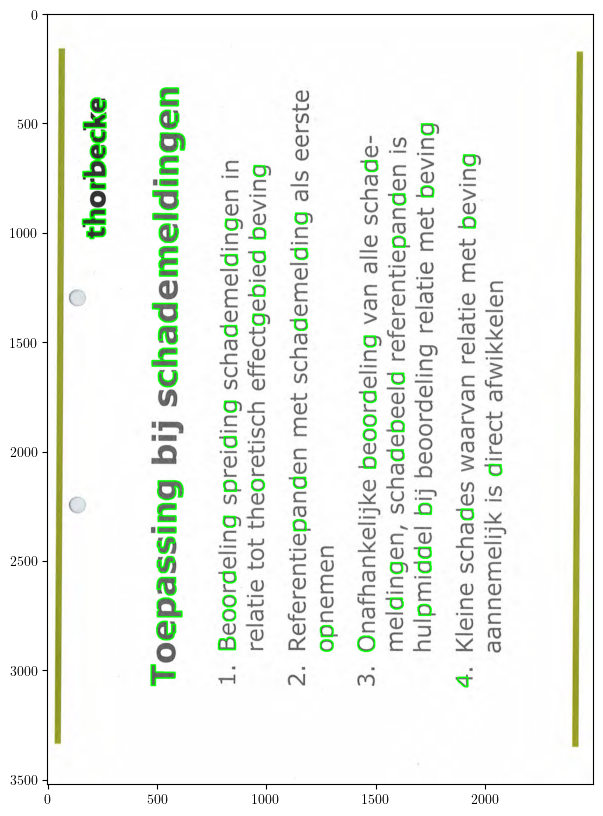

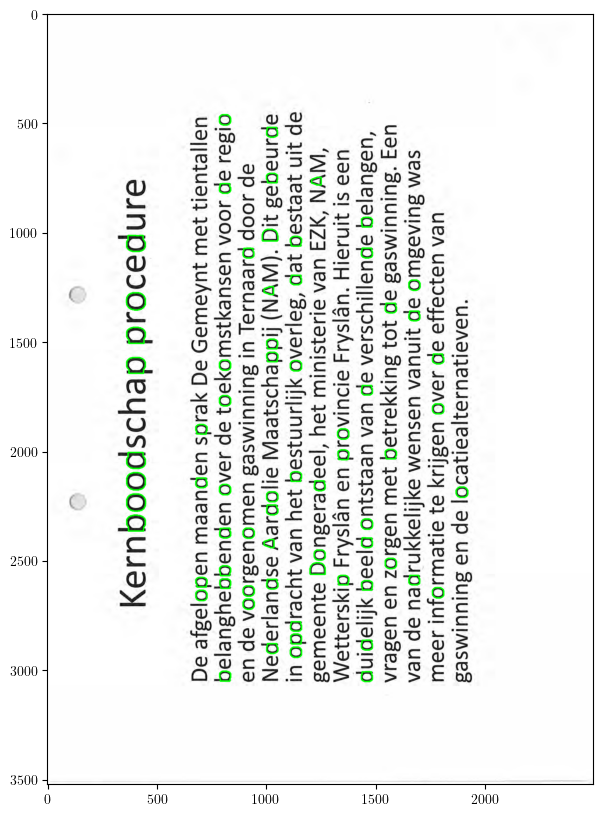

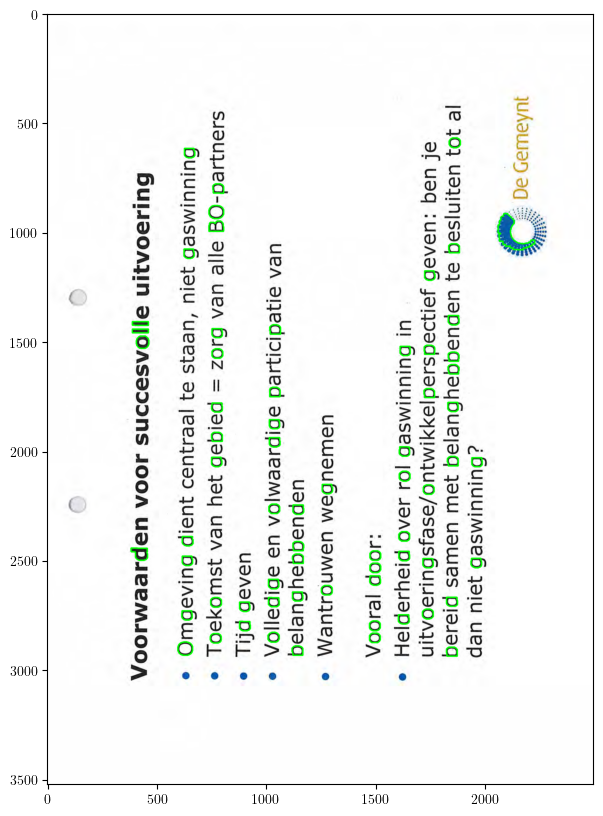

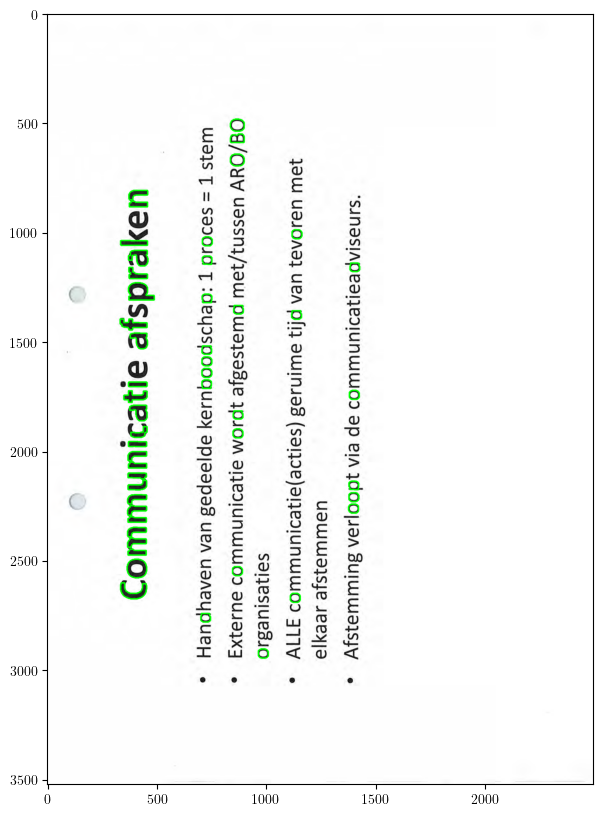

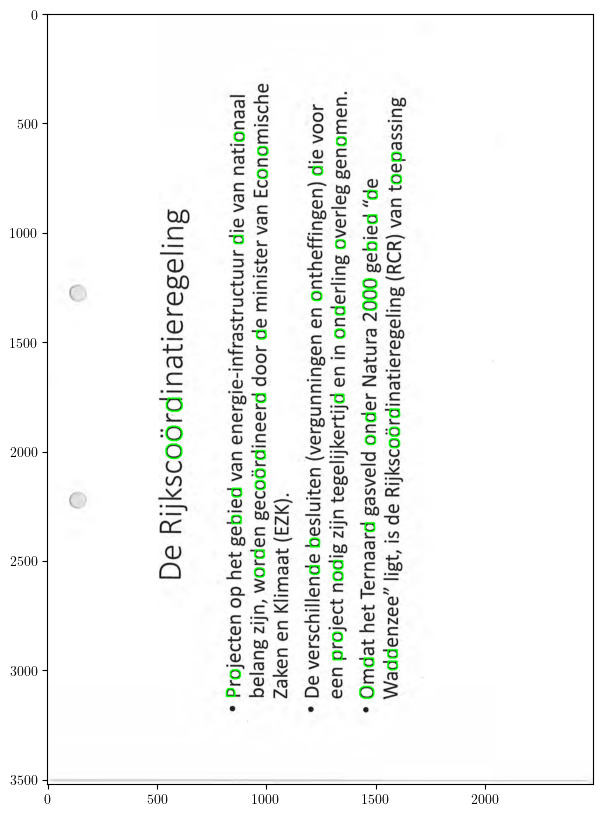

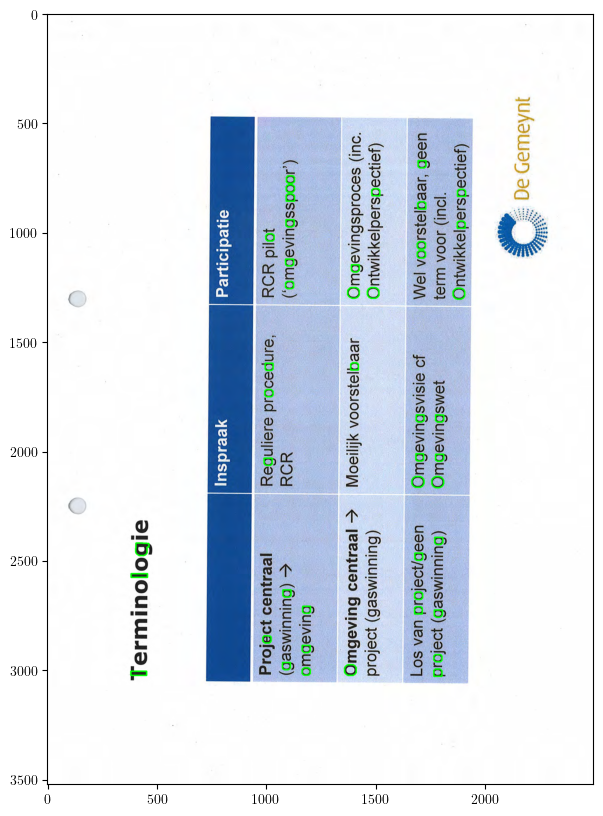

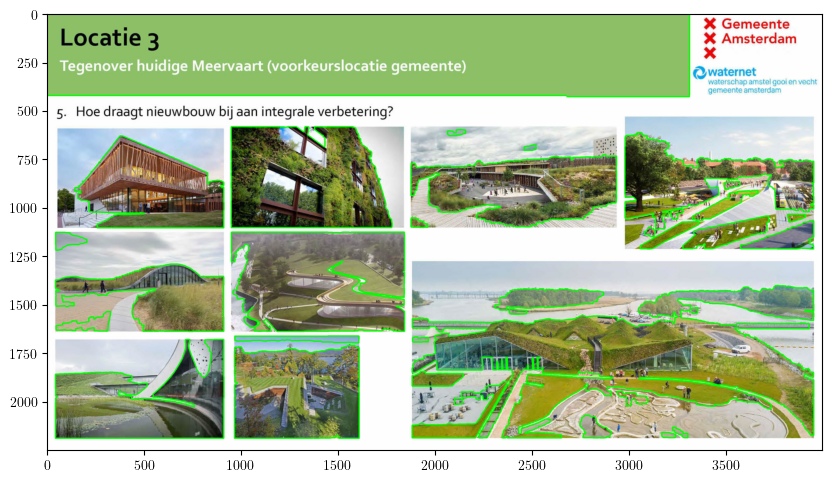

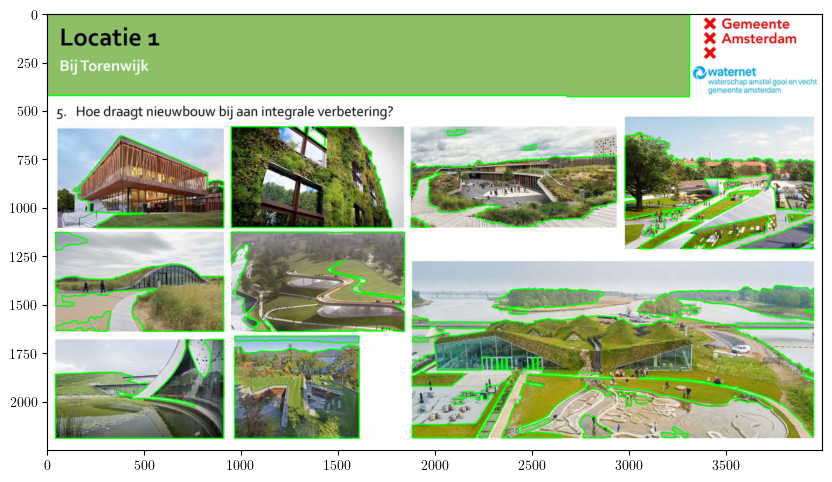

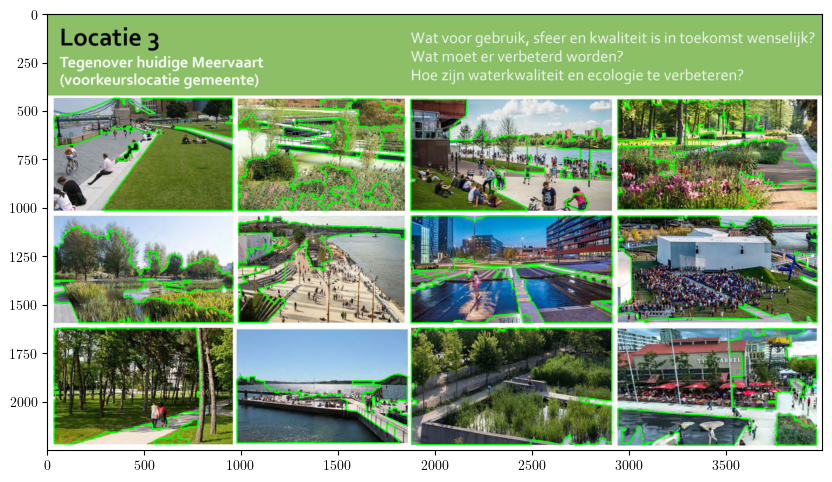

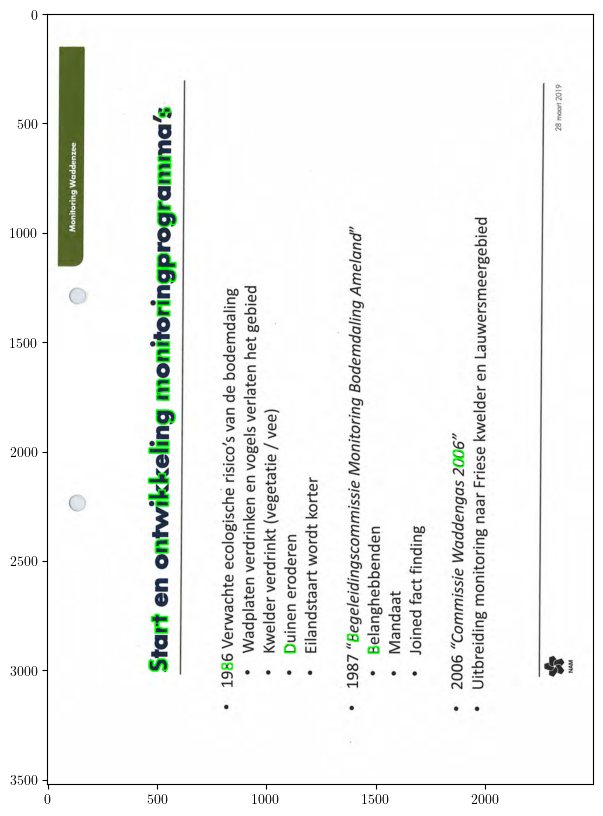

In [42]:
# show the images including predictions of the ocr model
show_ocr_results(ocr_no_annotations, 10)

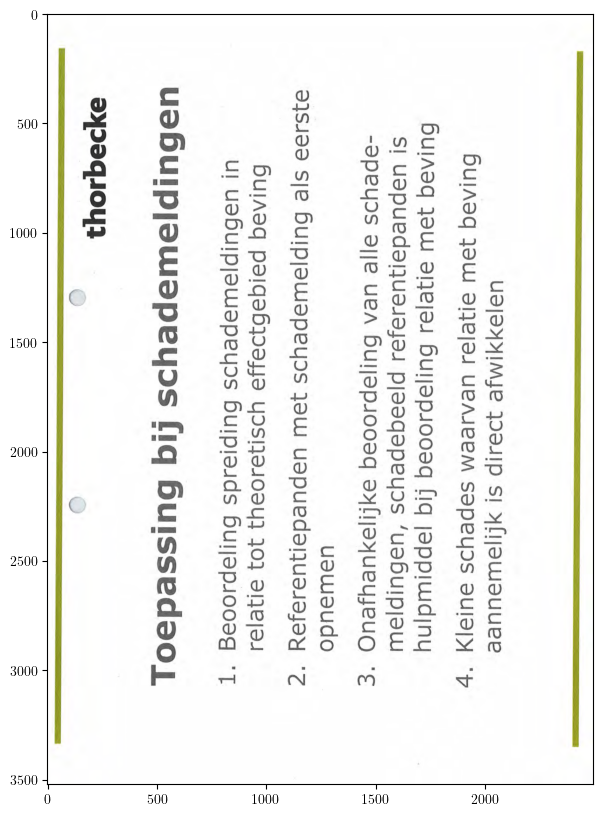

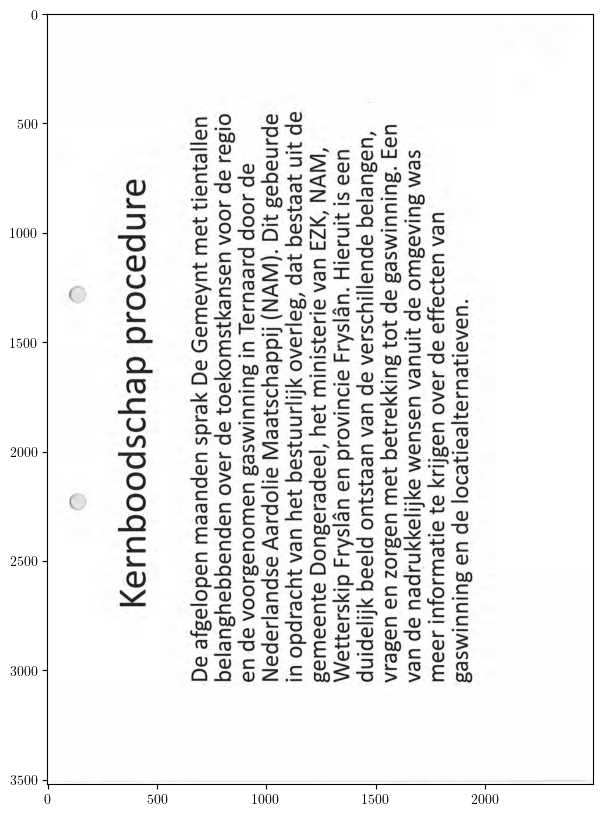

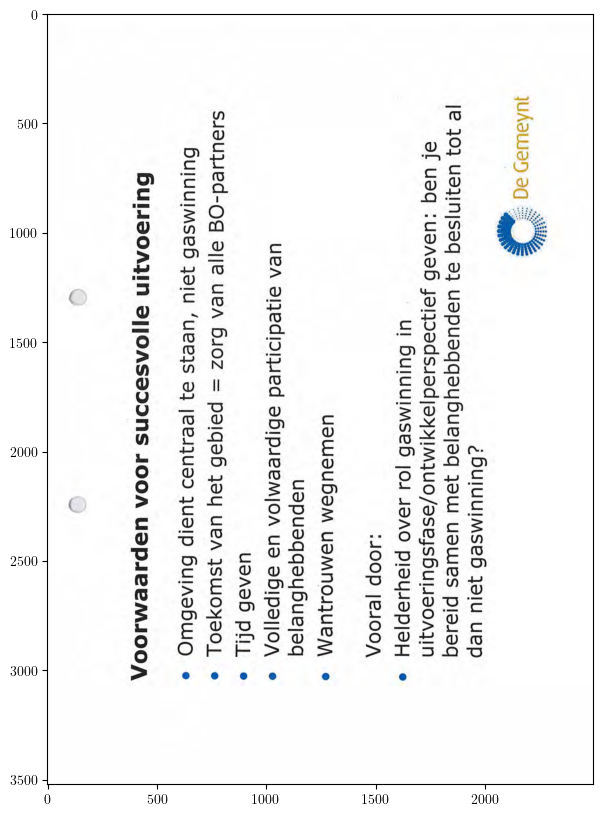

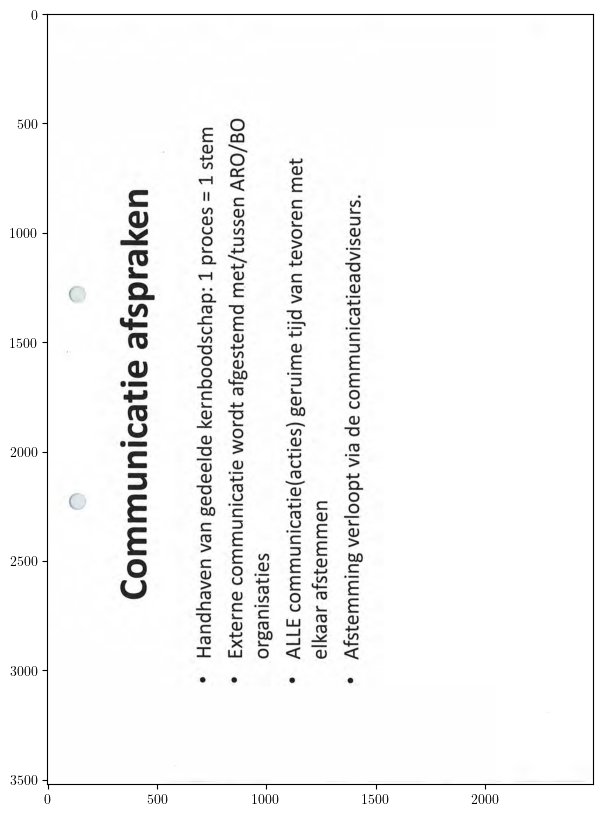

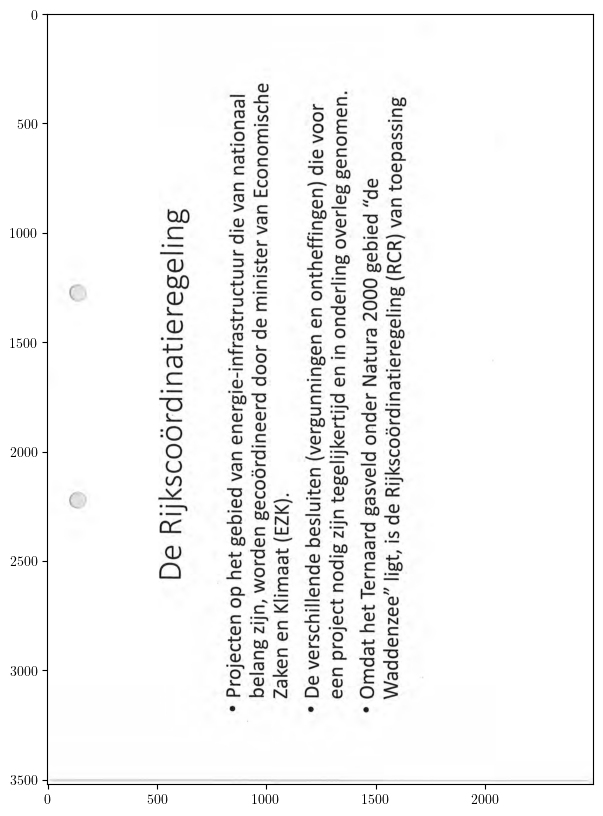

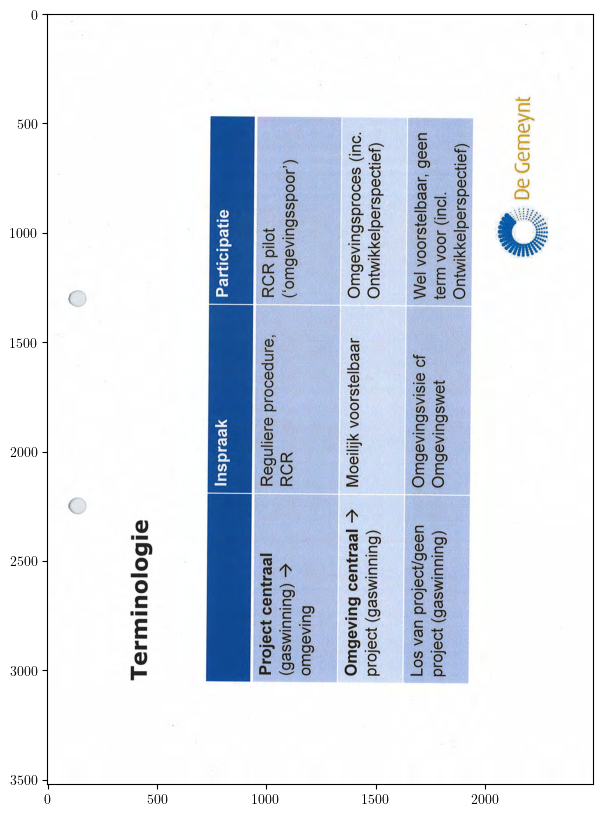

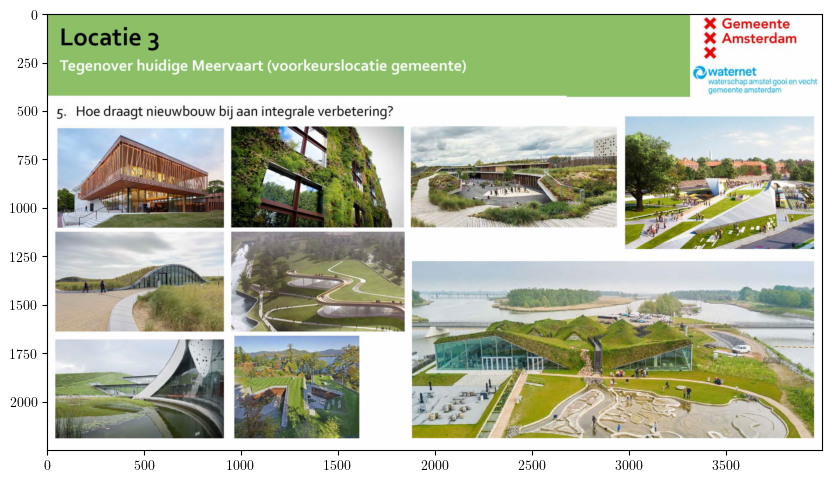

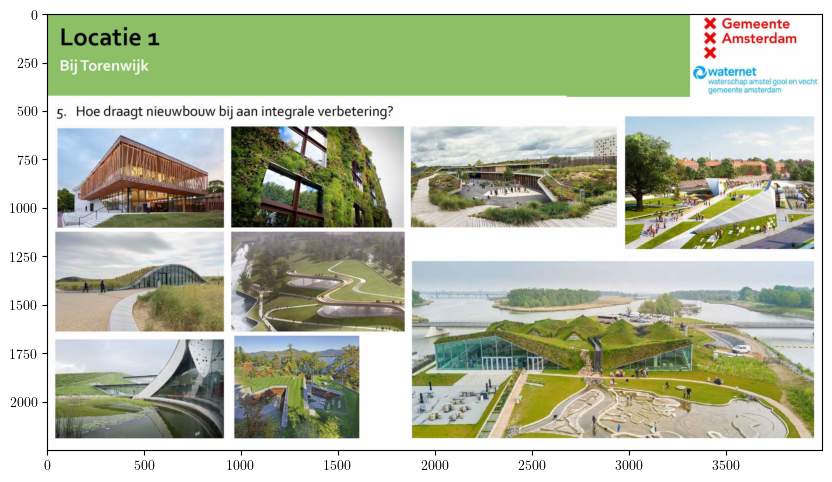

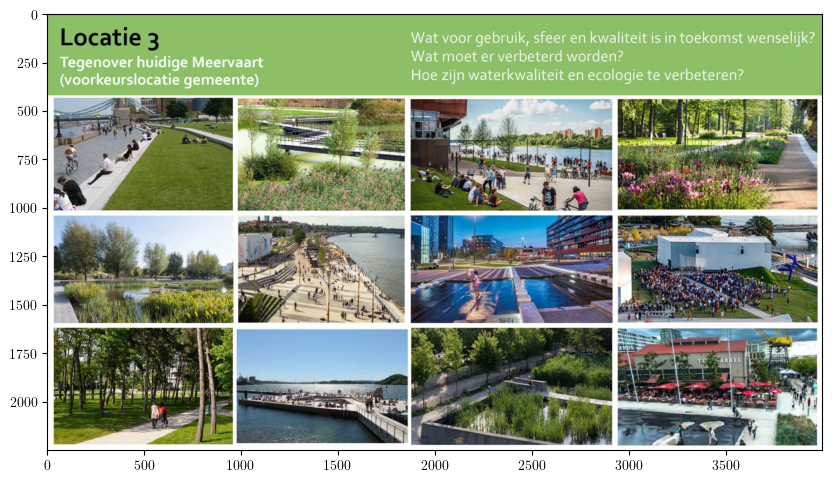

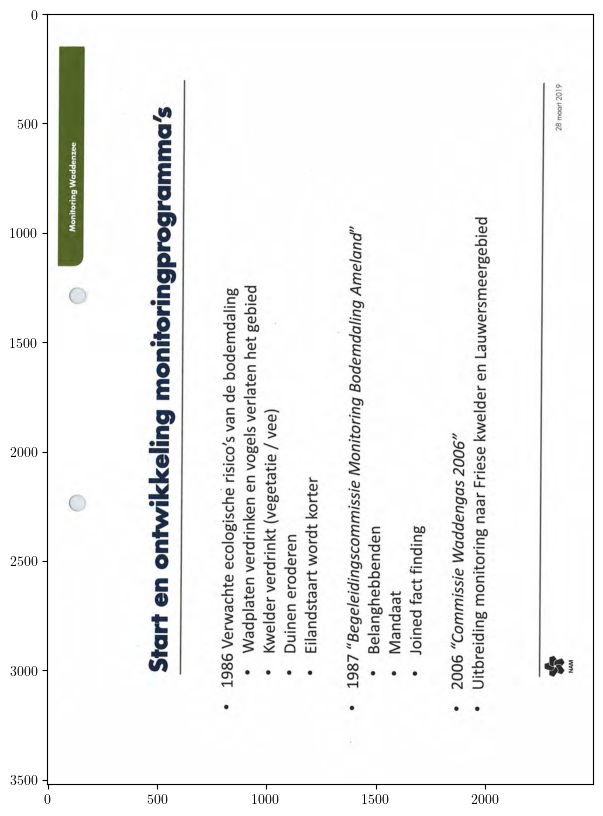

In [43]:
# show the images including predictions of the mask r-cnn model
show_maskrcnn_results(ocr_no_annotations, 10)

# Analysis of the pages with the worst PQ-score of the Mask R-CNN model

In [44]:
# join the mask r-cnn results with the pq score per page
maskrcnn_extended_pq = metric_calculation(maskrcnn_extended_results)
maskrcnn_extended_complete = maskrcnn_extended_results.join(maskrcnn_extended_pq)

In [45]:
# filter on the pages with border redactions and sort by the lowest recall
# since these documents have the largest negatige effect on the recall of the ocr model
maskrcnn_terrible_pq = maskrcnn_extended_complete[maskrcnn_extended_complete['type'] != 'no_annotation'].sort_values(by=['PQ'], ascending=True)
maskrcnn_terrible_pq.head(10)

,TP,FP,FN,IOU,area,size,type,Ratio redacted area,PQ,SQ,RQ,P,R
file,,,,,,,,,,,,,
bijlage-beslisnota-s-mirt-overzicht-2023-deltaprogramma-2023-en-geactualiseerde-spelregels-van-het-mirt-6.png,0,0,2,0.0,<NA>,8697360,gray,<NA>,0.00,0.00,0.00,0.00,0.00
documenten-180-226-22.png,0,1,7,0.0,5876,8710364,gray,0.000675,0.00,0.00,0.00,0.00,0.00
nl.mnre1058.2i.2022.1.misc.9-50.png,0,0,1,0.0,<NA>,8415000,gray,<NA>,0.00,0.00,0.00,0.00,0.00
nl.mnre1058.2i.2022.1.misc.9-51.png,0,0,1,0.0,<NA>,8415000,gray,<NA>,0.00,0.00,0.00,0.00,0.00
documenten-180-226-5.png,1,1,2,0.835065,22326,8710364,gray,0.002563,0.33,0.84,0.40,0.50,0.33
documenten-180-226-90.png,4,2,11,3.461306,95868,8710364,gray,0.011006,0.33,0.87,0.38,0.67,0.27
0007-page1.png,1,1,1,0.870273,2050,3740000,gray,0.000548,0.44,0.87,0.50,0.50,0.50
bijlage-beslisnota-s-mirt-overzicht-2023-deltaprogramma-2023-en-geactualiseerde-spelregels-van-het-mirt-2.png,1,1,1,0.897855,41872,8697360,gray,0.004814,0.45,0.90,0.50,0.50,0.50
Gelakte stukken Wob-verzoek omgevingsproces Ternaard 2e deel-160.png,4,6,0,3.179059,314675,8785920,gray,0.035816,0.45,0.79,0.57,0.40,1.00


In [46]:
# show the images including predictions of the mask r-cnn model
#show_maskrcnn_results(maskrcnn_terrible_pq, 5, False)

## Now just for pages with a PQ-score higher than 0

In [47]:
# filter on the pages with border redactions and sort by the lowest recall
# since these documents have the largest negatige effect on the recall of the ocr model
maskrcnn_poor_pq = maskrcnn_extended_complete[maskrcnn_extended_complete['PQ'] > 0].sort_values(by=['PQ'], ascending=True)
maskrcnn_poor_pq.head(20)

,TP,FP,FN,IOU,area,size,type,Ratio redacted area,PQ,SQ,RQ,P,R
file,,,,,,,,,,,,,
documenten-180-226-90.png,4,2,11,3.461306,95868,8710364,gray,0.011006,0.33,0.87,0.38,0.67,0.27
documenten-180-226-5.png,1,1,2,0.835065,22326,8710364,gray,0.002563,0.33,0.84,0.40,0.50,0.33
0007-page1.png,1,1,1,0.870273,2050,3740000,gray,0.000548,0.44,0.87,0.50,0.50,0.50
bijlage-beslisnota-s-mirt-overzicht-2023-deltaprogramma-2023-en-geactualiseerde-spelregels-van-het-mirt-2.png,1,1,1,0.897855,41872,8697360,gray,0.004814,0.45,0.90,0.50,0.50,0.50
Gelakte stukken Wob-verzoek omgevingsproces Ternaard 2e deel-160.png,4,6,0,3.179059,314675,8785920,gray,0.035816,0.45,0.79,0.57,0.40,1.00
documenten-180-226-88.png,6,2,4,4.95737,255502,8710364,gray,0.029333,0.55,0.83,0.67,0.75,0.60
nl.mnre1058.2i.2022.1.misc.9-42.png,11,2,7,8.591233,37919,8415000,border,0.004506,0.55,0.78,0.71,0.85,0.61
nl.mnre1058.2i.2022.1.misc.9-31.png,10,0,6,7.249551,26091,8415000,border,0.003101,0.56,0.72,0.77,1.00,0.62
Wob-besluit-Project-No-Waste-2021-011855__concatenated-page-011.png,4,3,1,3.465058,104601,8703348,black,0.012018,0.58,0.87,0.67,0.57,0.80


In [48]:
# show the images including predictions of the mask r-cnn model
# show_maskrcnn_results(maskrcnn_poor_pq, 20, True)